In [9]:
# New Dataset
import cv2
import torch
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
import numpy as np
import pandas as pd
from torchvision import transforms
import imageio
import os
from PIL import Image
import torchvision.utils as vutils
import matplotlib.pyplot as plt

import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision.models as models



In [7]:
class VideoFrameActionDataset(Dataset):
    def __init__(self, video_folder_path, csv_folder_path, transform=None):
        interval_frames = 10
        self.transform = transforms.Compose([
            transforms.Resize((64, 64)),
            transforms.ToTensor(),
            transforms.Normalize([0.5]*3, [0.5]*3)
        ]) if transform is None else transform

        self.video_folder_path = video_folder_path
        self.csv_folder_path = csv_folder_path
        self.cache_dir = "C:\\Users\\44753\\Desktop\\cache"
        os.makedirs(self.cache_dir, exist_ok=True)

        self.all_videos = self.list_files_in_folder(self.video_folder_path)
        self.all_csv = self.list_files_in_folder(self.csv_folder_path)

        self.frames = []
        self.stick_labels = []
        self.button_labels = []

        for i in range(len(self.all_videos)):
            cache_file = os.path.join(self.cache_dir, f"video_{i:03d}.pt")
            if os.path.exists(cache_file):
                print(f"Loading cache: {cache_file}")
                cached = torch.load(cache_file)
                self.frames.extend(cached["frames"])
                self.stick_labels.extend(cached["stick_labels"])
                self.button_labels.extend(cached["button_labels"])
                continue

            print(f"Processing video {i}: building data...")
            current_video_path = self.video_folder_path + "\\" + self.all_videos[i]
            current_csv_path = self.csv_folder_path + "\\" + self.all_csv[i]
            data = pd.read_csv(current_csv_path)

            reader = imageio.get_reader(current_video_path, 'ffmpeg')
            all_frames = [reader.get_data(j) for j in range(reader.count_frames())]
            reader.close()

            frame_ids = data["VFRAME_ID"].values.astype(int)
            stick_col = ['LSTICKX', 'LSTICKY', 'RSTICKX', 'RSTICKY', 'R2']
            button_col = ['L1', 'R1', 'L2', 'L3', 'R3', 'DPAD_UP', 'DPAD_DOWN', 'DPAD_LEFT', 'DPAD_RIGHT', 'TRI', 'SQUARE', 'CROSS', 'CIRCLE', 'TOUCHPAD', 'TOUCHPOINT0_ID', 'TOUCHPOINT0_X', 'TOUCHPOINT0_y', 'TOUCHPOINT1_ID', 'TOUCHPOINT1_X', 'TOUCHPOINT1_y']

            stick_values = data[stick_col].values.astype(np.float32) / 255.0
            button_values = data[button_col].values.astype(np.uint8)

            
            video_frames = []
            video_stick = []
            video_button = []

            for j, frame_id in enumerate(frame_ids):
                if frame_id + interval_frames >= len(all_frames):
                    continue
                cframe1 = self.transform(Image.fromarray(all_frames[frame_id - 1]))
                cframe2 = self.transform(Image.fromarray(all_frames[frame_id + interval_frames - 1]))
                video_frames.append((cframe1, cframe2))
                video_stick.append(stick_values[j])
                video_button.append(button_values[j])

            self.frames.extend(video_frames)
            self.stick_labels.extend(video_stick)
            self.button_labels.extend(video_button)

            # Save Built Dataset
            torch.save({
                "frames": video_frames,
                "stick_labels": video_stick,
                "button_labels": video_button
            }, cache_file)
            print(f"Saved cache to {cache_file}")

    def __len__(self):
        return len(self.frames)

    def __getitem__(self, i):
        return self.frames[i], self.stick_labels[i], self.button_labels[i]

    def list_files_in_folder(self, folder_path):
        return sorted(os.listdir(folder_path))


In [8]:
video_folder_path = "C:\\Users\\44753\\Desktop\\Videostest"
csv_folder_path = "C:\\Users\\44753\\Desktop\\Maintest"
dataset = VideoFrameActionDataset(video_folder_path, csv_folder_path, transform=None)
dataloader = DataLoader(dataset, batch_size=64, shuffle=True)

Loading cache: C:\Users\44753\Desktop\cache\video_000.pt


C:\Users\44753\AppData\Local\Temp\ipykernel_14308\229433362.py:26: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  cached = torch.load(cache_file)


Loading cache: C:\Users\44753\Desktop\cache\video_001.pt
Loading cache: C:\Users\44753\Desktop\cache\video_002.pt
Loading cache: C:\Users\44753\Desktop\cache\video_003.pt
Loading cache: C:\Users\44753\Desktop\cache\video_004.pt
Loading cache: C:\Users\44753\Desktop\cache\video_005.pt
Loading cache: C:\Users\44753\Desktop\cache\video_006.pt
Loading cache: C:\Users\44753\Desktop\cache\video_007.pt
Loading cache: C:\Users\44753\Desktop\cache\video_008.pt
Loading cache: C:\Users\44753\Desktop\cache\video_009.pt
Loading cache: C:\Users\44753\Desktop\cache\video_010.pt


In [7]:
# Check table columns
import pandas as pd
import os

action_path= "C:\\Users\\44753\\Desktop\\Main"
files = os.listdir(action_path)

for i in range(len(files)):
    path = action_path + '\\' + files[i]
    df = pd.read_csv(path)
    column_types = {}
    
    for col in df.columns[2:]:  # skip "frame" and "timestamp" columns
        unique_vals = df[col].dropna().unique()
        num_unique = len(unique_vals)

        if num_unique <= 2 and set(unique_vals).issubset({0, 1}):
            column_types[col] = "binary"  # values with 0/1
        elif df[col].max() <= 255:
            column_types[col] = "analog"  # values between 0/255
        else:
            column_types[col] = "unknown"

stick_col = [k for k, v in column_types.items() if v == 'analog']
button_col = [k for k, v in column_types.items() if v == 'binary']
print(stick_col)
print(button_col)

['LSTICKX', 'LSTICKY', 'RSTICKX', 'RSTICKY', 'R2']
['L1', 'R1', 'L2', 'L3', 'R3', 'DPAD_UP', 'DPAD_DOWN', 'DPAD_LEFT', 'DPAD_RIGHT', 'TRI', 'SQUARE', 'CROSS', 'CIRCLE', 'TOUCHPAD', 'TOUCHPOINT0_ID', 'TOUCHPOINT0_X', 'TOUCHPOINT0_y', 'TOUCHPOINT1_ID', 'TOUCHPOINT1_X', 'TOUCHPOINT1_y']


In [ ]:
# Old Dataset Class

In [25]:
'''
from torch.utils.data import Dataset
from torchvision import transforms
from PIL import Image
import os

class FramePairDataset(Dataset):
    def __init__(self, frame_dir, transform=None):
        self.frame_dir = frame_dir
        self.transform = transform or transforms.ToTensor()

        #sort
        file_list = os.listdir(frame_dir)
        image_list = [f for f in file_list if f.endswith('.jpg') or f.endswith('.png')]
        image_list.sort()
        self.frame_paths = [os.path.join(frame_dir, f) for f in image_list]

    def __len__(self):
        return len(self.frame_paths) - 1

    def __getitem__(self, idx):
        img1 = Image.open(self.frame_paths[idx]).convert('RGB')
        img2 = Image.open(self.frame_paths[idx + 1]).convert('RGB')

        img1 = self.transform(img1)
        img2 = self.transform(img2)

        return img1, img2  # two sequential frames (s_t, s_{t+1})
'''

In [26]:
'''
from torch.utils.data import DataLoader
from torchvision import transforms

transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor(), 
    transforms.Normalize([0.5]*3, [0.5]*3)  # → [-1, 1]
    
])


frame_dir = "C:\\Users\\44753\\Desktop\\Frames"

dataset = FramePairDataset(frame_dir, transform=transform)
dataloader = DataLoader(dataset, batch_size=64, shuffle=True)
'''

In [10]:
# Inverse Dynamic Model
class InverseDynamicsModel(nn.Module):
    def __init__(self, state_dim=128, latent_dim=32):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(state_dim * 2, 128),
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Linear(128, latent_dim)
        )

    def forward(self, s1_embed, s2_embed):
        x = torch.cat([s1_embed, s2_embed], dim=1)
        return self.net(x)  # output latent action


In [11]:
# VectorQuantizerEMA
class VectorQuantizerEMA(nn.Module):
    def __init__(self, num_embeddings, embedding_dim, commitment_cost=0.25, decay=0.99, eps=1e-5):
        super().__init__()
        self.embedding_dim = embedding_dim
        self.num_embeddings = num_embeddings
        self.commitment_cost = commitment_cost
        self.decay = decay
        self.eps = eps

        embed = torch.randn(embedding_dim, num_embeddings)
        self.register_buffer("embedding", embed)
        self.register_buffer("cluster_size", torch.zeros(num_embeddings))
        self.register_buffer("embed_avg", embed.clone())

    def forward(self, z):
        z_flattened = z.view(-1, self.embedding_dim)
        distances = (
            torch.sum(z_flattened ** 2, dim=1, keepdim=True)
            - 2 * torch.matmul(z_flattened, self.embedding)
            + torch.sum(self.embedding ** 2, dim=0, keepdim=True)
        )
        encoding_indices = torch.argmin(distances, dim=1).unsqueeze(1)
        encodings = torch.zeros(encoding_indices.size(0), self.num_embeddings, device=z.device)
        encodings.scatter_(1, encoding_indices, 1)

        quantized = torch.matmul(encodings, self.embedding.t()).view(z.shape)

        if self.training:
            self.cluster_size.data.mul_(self.decay).add_((1 - self.decay) * encodings.sum(0))
            embed_sum = torch.matmul(z_flattened.t(), encodings)
            self.embed_avg.data.mul_(self.decay).add_((1 - self.decay) * embed_sum)

            n = self.cluster_size.sum()
            cluster_size = (
                (self.cluster_size + self.eps) / (n + self.num_embeddings * self.eps) * n
            )
            self.embedding.data = self.embed_avg / cluster_size.unsqueeze(0)

        quantized = z + (quantized - z).detach()
        loss = self.commitment_cost * F.mse_loss(quantized.detach(), z)
        return quantized, loss


In [12]:
# IMPALA-CNN Encoder

class ResidualBlock(nn.Module):
    def __init__(self, channels):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReLU(),
            nn.Conv2d(channels, channels, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(channels, channels, kernel_size=3, padding=1)
        )

    def forward(self, x):
        return x + self.block(x)

class ImpalaBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.pool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1)
        self.res1 = ResidualBlock(out_channels)
        self.res2 = ResidualBlock(out_channels)

    def forward(self, x):
        x = self.pool(x)
        x = self.conv(x)
        x = self.res1(x)
        x = self.res2(x)
        return x

class ImpalaCNN(nn.Module):
    def __init__(self, in_channels=3, embedding_dim=128, channel_multiplier=1):
        super().__init__()
        c1, c2, c3 = 16 * channel_multiplier, 32 * channel_multiplier, 32 * channel_multiplier
        self.conv_seq = nn.Sequential(
            ImpalaBlock(in_channels, c1),
            ImpalaBlock(c1, c2),
            ImpalaBlock(c2, c3),
            nn.ReLU(),
            nn.Flatten()
        )
        # Assuming input image is 64x64, after 3 strided pools → size reduces to 8x8
        final_feat_dim = c3 * 8 * 8
        self.fc = nn.Linear(final_feat_dim, embedding_dim)

    def forward(self, x):
        x = self.conv_seq(x)
        x = self.fc(x)
        return x


In [13]:
# ---- ResNet Encoder ----
class ResNetEncoder(nn.Module):
    def __init__(self, pretrained=False):
        super().__init__()
        base = models.resnet18(pretrained=pretrained)
        self.layer0 = nn.Sequential(base.conv1, base.bn1, base.relu)  # 64x32x32
        self.layer1 = base.layer1                                     # 64x32x32
        self.layer2 = base.layer2                                     # 128x16x16
        self.layer3 = base.layer3                                     # 256x8x8
        self.layer4 = base.layer4                                     # 512x4x4

    def forward(self, x):
        x0 = self.layer0(x)
        x1 = self.layer1(x0)
        x2 = self.layer2(x1)
        x3 = self.layer3(x2)
        x4 = self.layer4(x3)
        return [x1, x2, x3, x4]  # Skip connections

# ---- U-Net Decoder ----
class UNetDecoder(nn.Module):
    def __init__(self, latent_dim=64, out_channels=3):
        super().__init__()
        self.up3 = self._up_block(512 + latent_dim + 256, 256)
        self.up2 = self._up_block(256 + 128, 128)
        self.up1 = self._up_block(128 + 64, 64)
        self.final = nn.Conv2d(64, out_channels, kernel_size=1)

    def _up_block(self, in_ch, out_ch):
        return nn.Sequential(
            nn.Upsample(scale_factor=2, mode='nearest'),
            nn.Conv2d(in_ch, out_ch, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(out_ch, out_ch, kernel_size=3, padding=1),
            nn.ReLU()
        )

    def forward(self, features, z_latent):
        B = z_latent.shape[0]
        z_feat = z_latent.view(B, -1, 1, 1).repeat(1, 1, 4, 4)  # match feature[3] (4x4)

        x = torch.cat([features[3], z_feat], dim=1)  # [B, 512+latent_dim, 4, 4]
        x = self.up3(torch.cat([x, self._resize(features[2], x)], dim=1))  # → 8×8
        x = self.up2(torch.cat([x, self._resize(features[1], x)], dim=1))  # → 16×16
        x = self.up1(torch.cat([x, self._resize(features[0], x)], dim=1))  # → 32×32
        x = F.interpolate(self.final(x), size=(64, 64), mode='bilinear', align_corners=False)
        return x

    def _resize(self, tensor, ref_tensor):
        return F.interpolate(tensor, size=ref_tensor.shape[-2:], mode='nearest')


# ---- Full FDM with ResNet-U-Net ----
class UNetFDM(nn.Module):
    def __init__(self, latent_dim=64):
        super().__init__()
        self.encoder = ResNetEncoder(pretrained=False)
        self.decoder = UNetDecoder(latent_dim=latent_dim, out_channels=3)

    def forward(self, s1_image, z_latent):
        features = self.encoder(s1_image)
        out = self.decoder(features, z_latent)
        return out  # predicted s_{t+1} image


In [ ]:
# ---- Old Latent Action Decoder ----
'''
class ActionDecoder(nn.Module):
    def __init__(self, latent_dim=32, num_actions=K):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(latent_dim, 64),
            nn.ReLU(),
            nn.Linear(64, 64),
            nn.ReLU(),
            nn.Linear(64, num_actions)  # output logits
        )

    def forward(self, z_q):
        return self.net(z_q)  # logits, shape [B, num_actions]
'''

In [14]:
# ---- New Latent Action Decoder ----
class ActionDecoder(nn.Module):
    def __init__(self, latent_dim=32, stick_dim=5, num_buttons=20):
        super().__init__()
        self.shared = nn.Sequential(
            nn.Linear(latent_dim, 64),
            nn.ReLU(),
            nn.Linear(64, 64),
            nn.ReLU(),
        )
        self.stick_head = nn.Linear(64, stick_dim)           # stick action head
        self.button_head = nn.Linear(64, num_buttons)        # button action head

    def forward(self, z_q):
        x = self.shared(z_q)
        stick_pred = self.stick_head(x)           # shape: [B, 5]
        button_logits = self.button_head(x)       # shape: [B, 20]
        return stick_pred, button_logits


In [15]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
encoder = ImpalaCNN(embedding_dim=128, channel_multiplier=4).to(device)

idm = InverseDynamicsModel(state_dim=128, latent_dim=32).to(device)


vq = VectorQuantizerEMA(
    num_embeddings=64,
    embedding_dim=32,
    commitment_cost=0.05,
    decay=0.999
).to(device)

fdm = UNetFDM(latent_dim=32).to(device)
action_decoder = ActionDecoder(latent_dim=32).to(device)

C:\Anaconda\envs\cude_test\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Anaconda\envs\cude_test\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


In [30]:
# Train

----------------Start Training-----------------


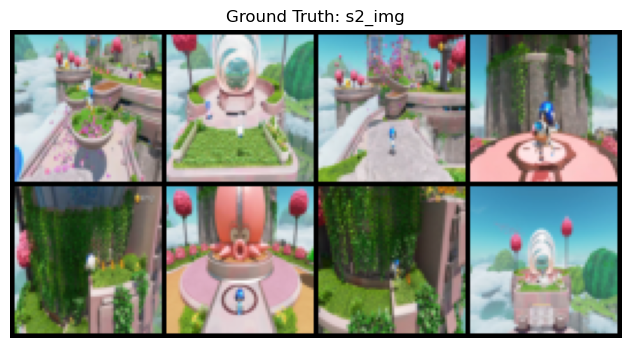

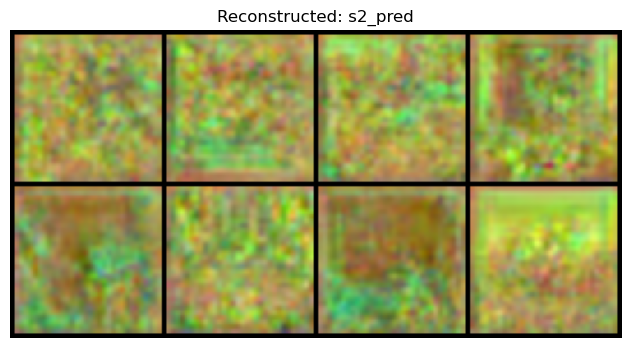

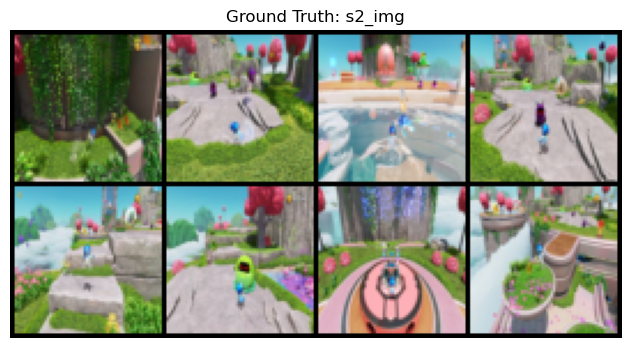

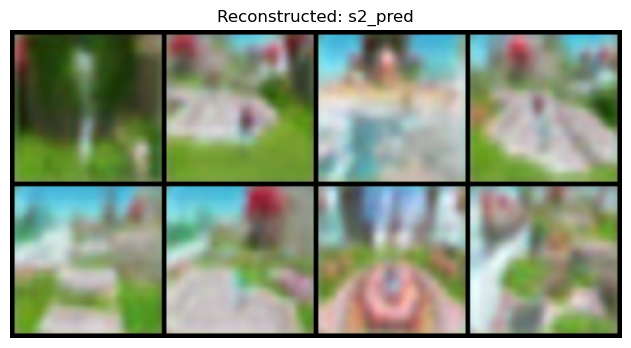

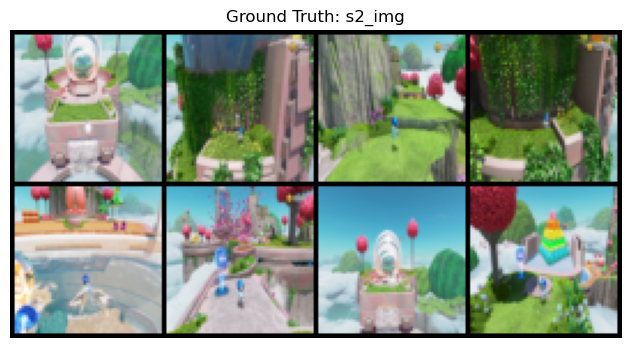

...

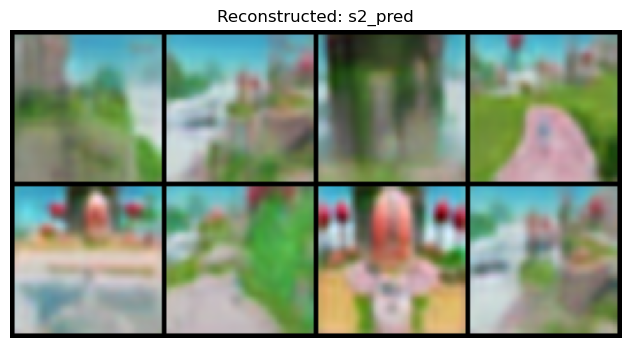

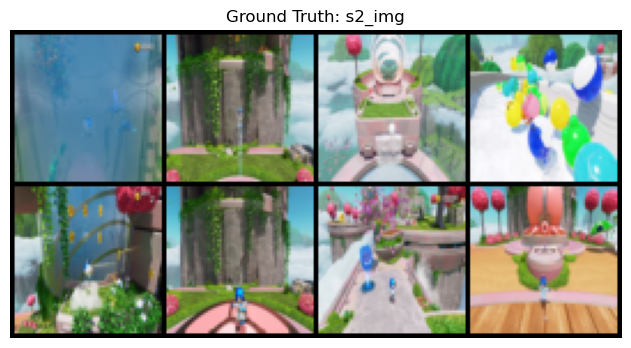

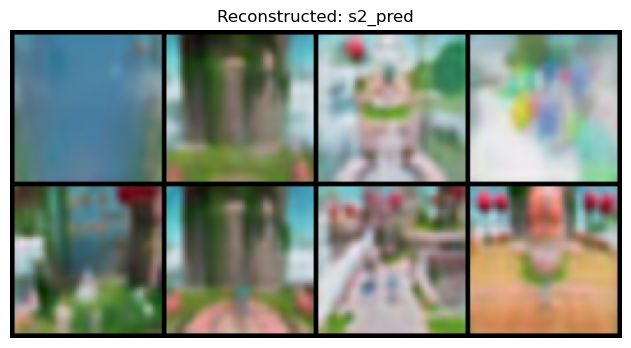

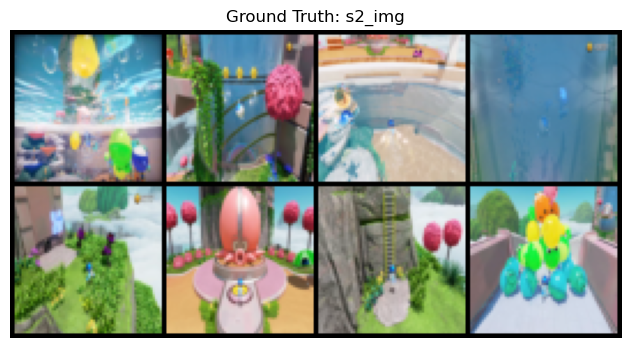

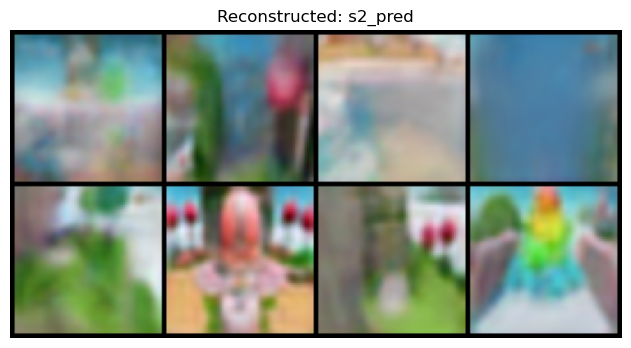

Epoch 1, Total Loss: 0.3721


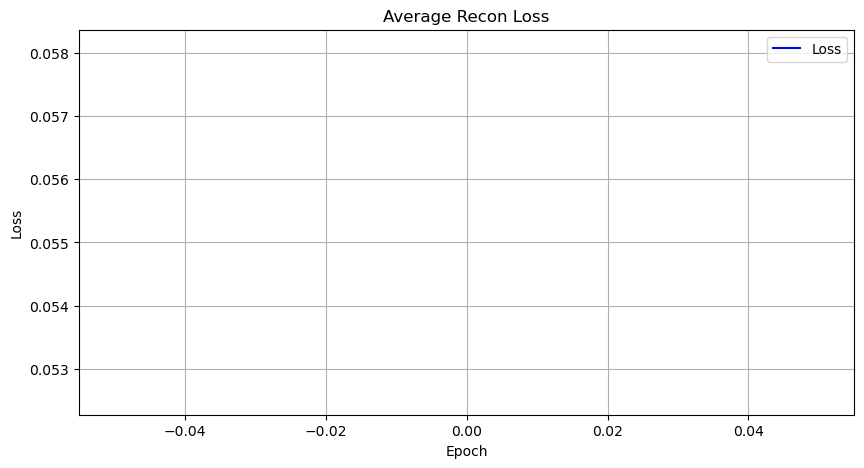

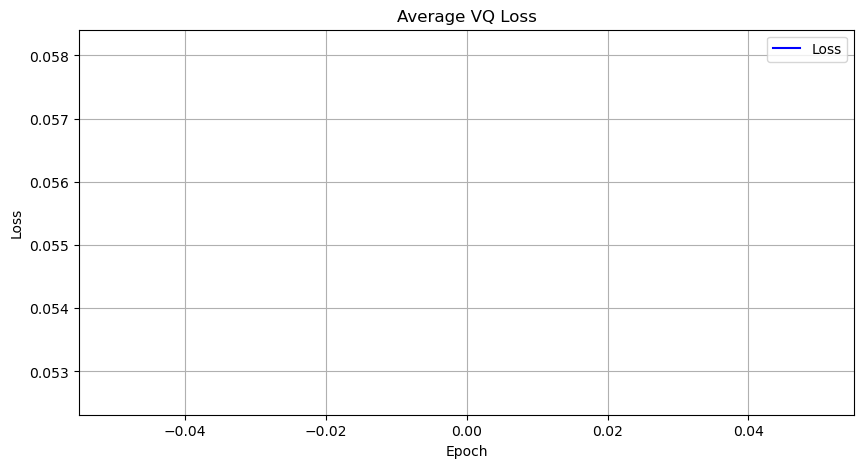

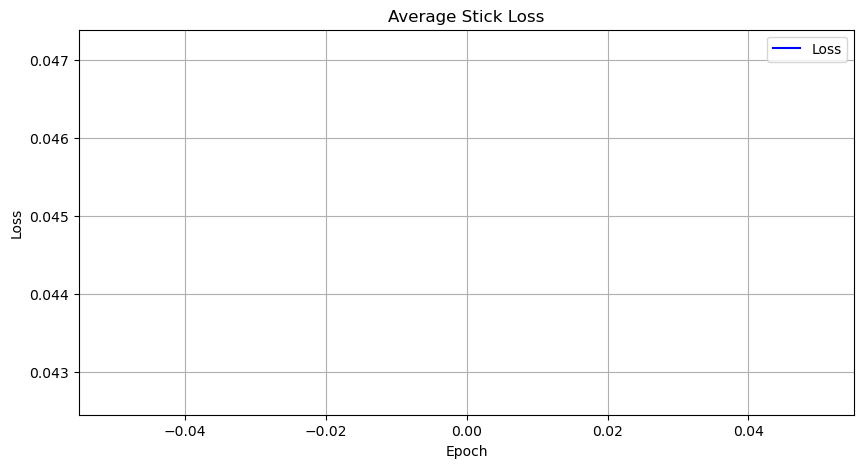

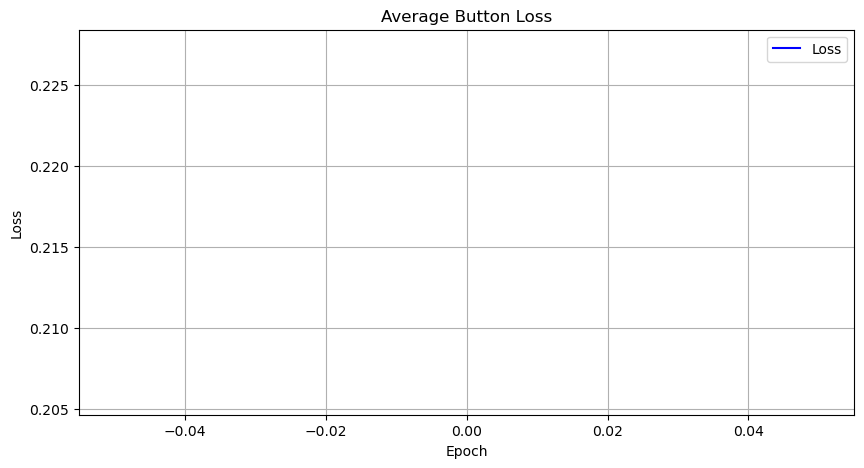

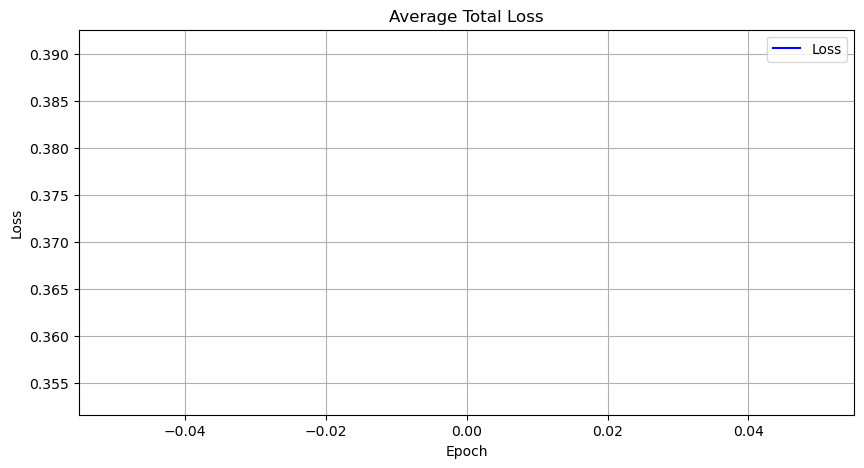

...

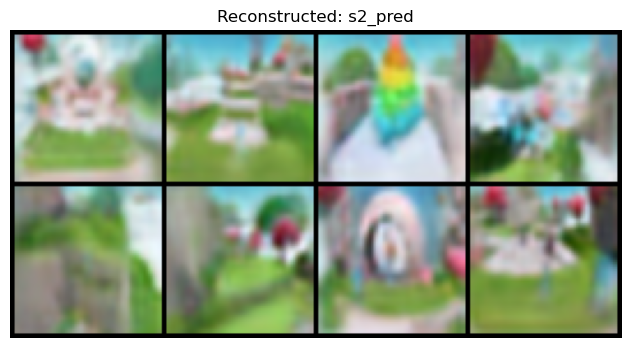

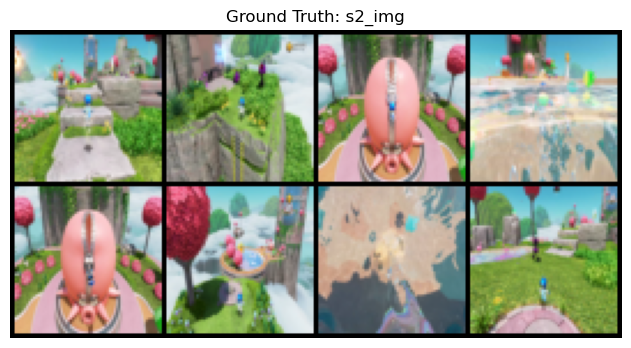

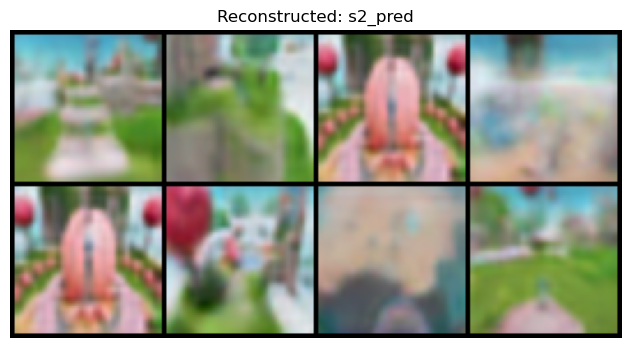

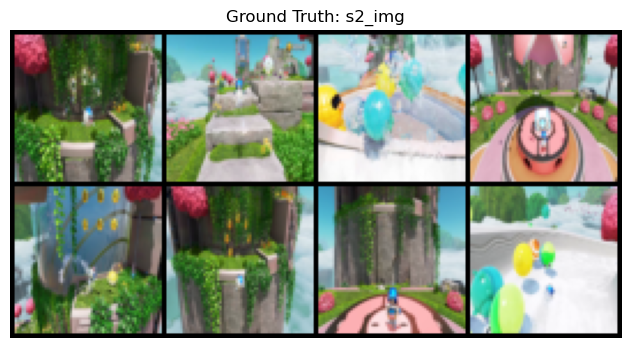

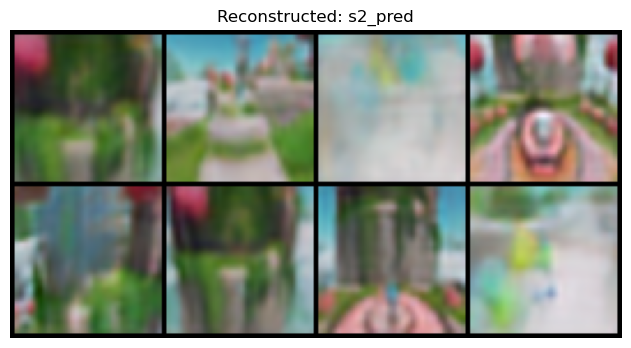

Epoch 2, Total Loss: 0.2894


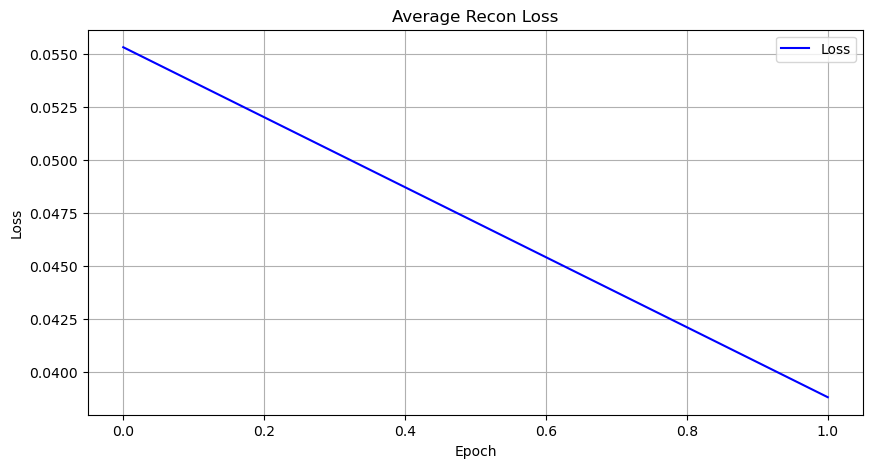

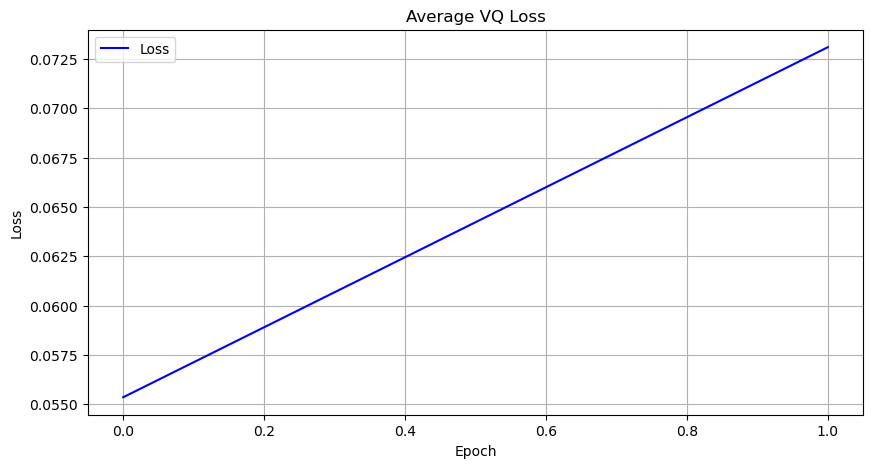

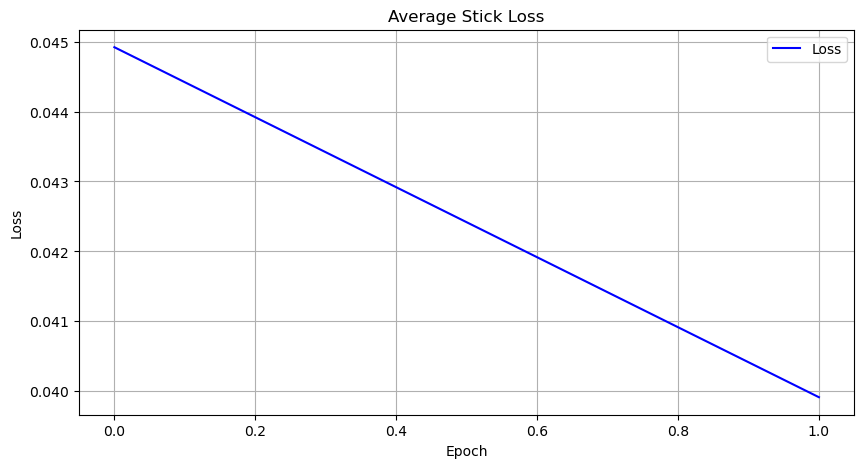

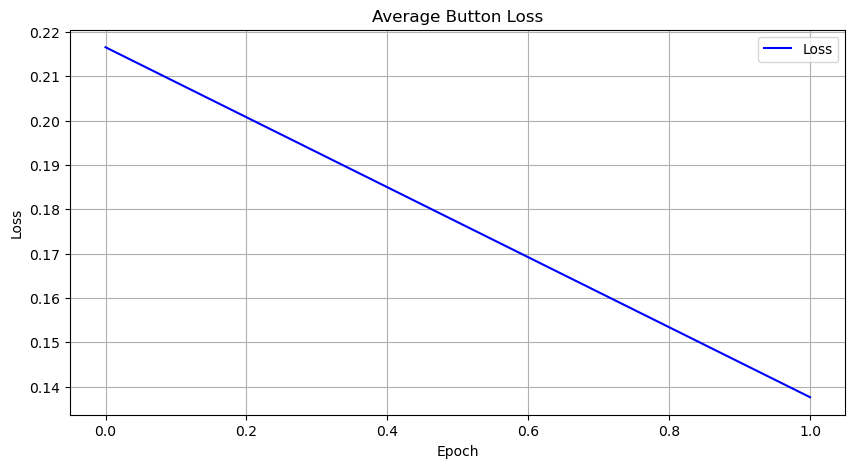

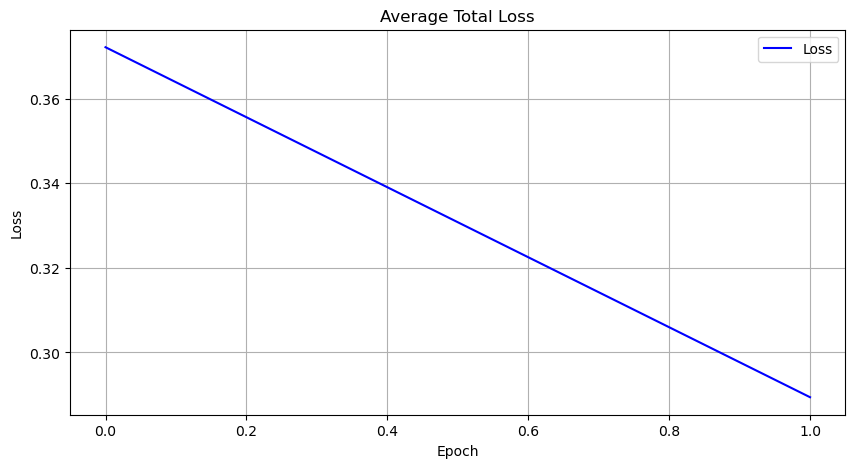

...

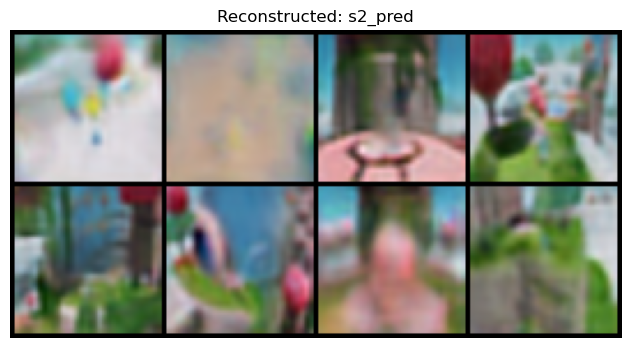

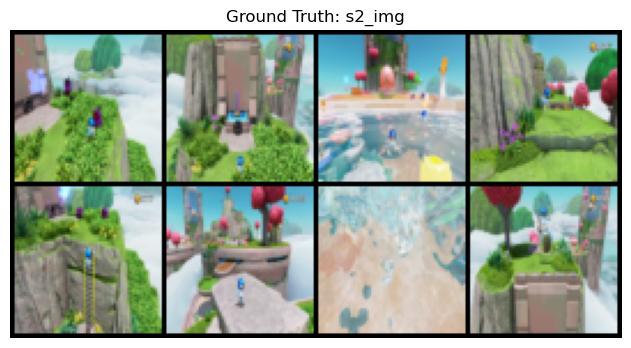

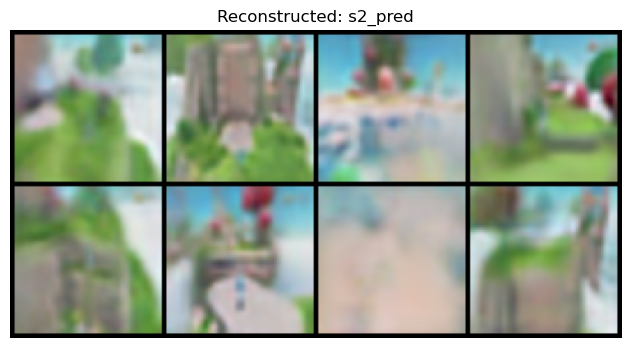

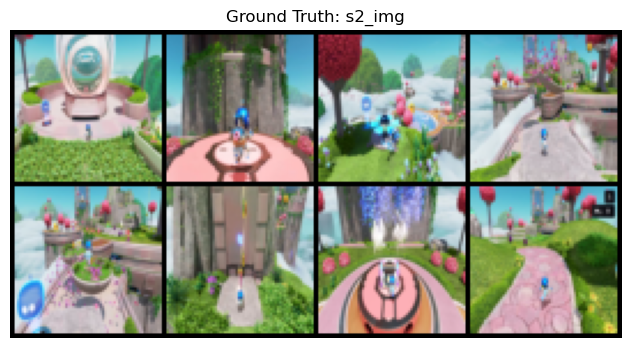

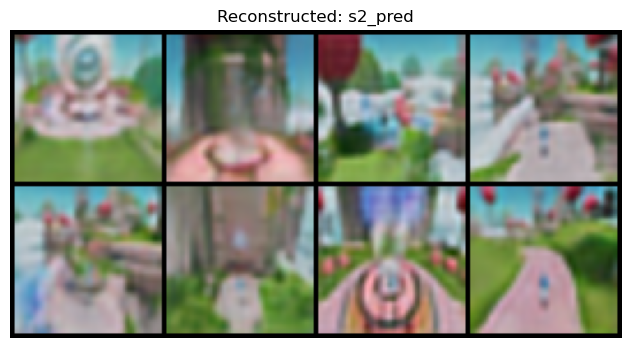

Epoch 3, Total Loss: 0.2919


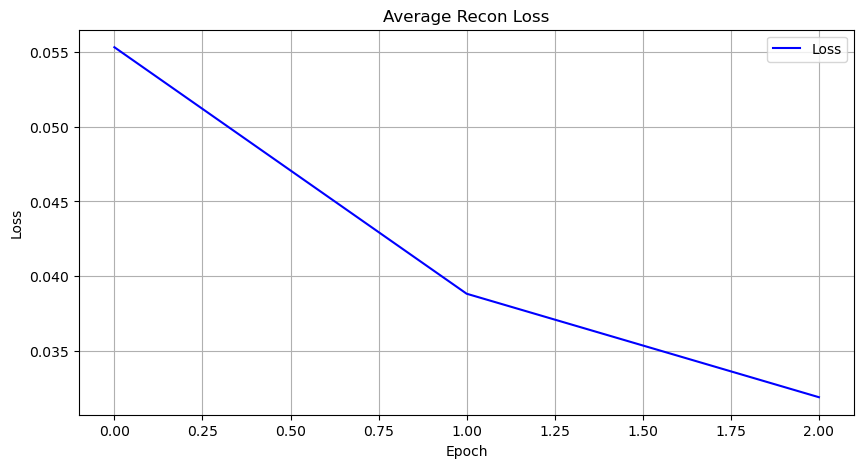

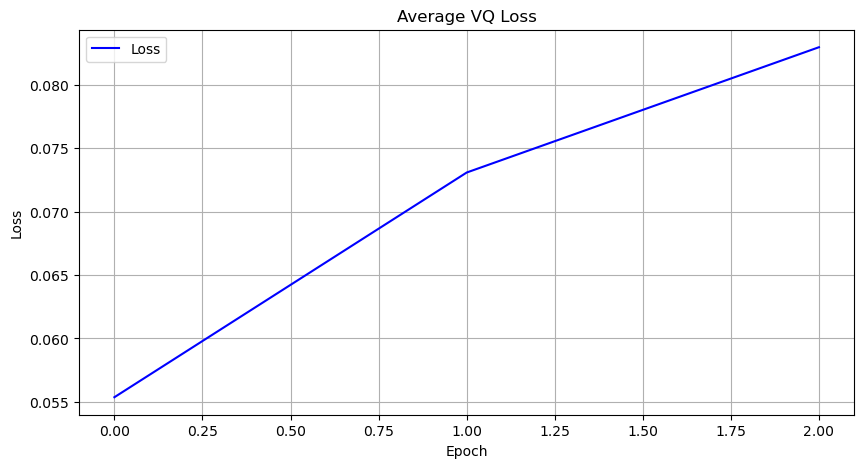

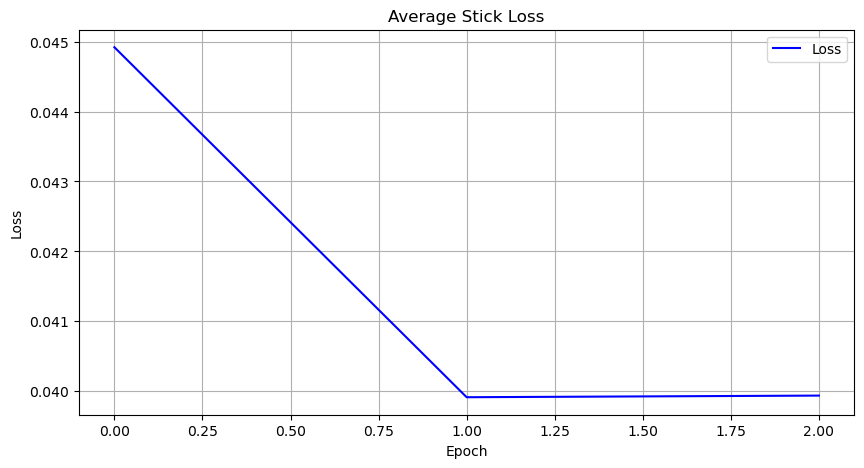

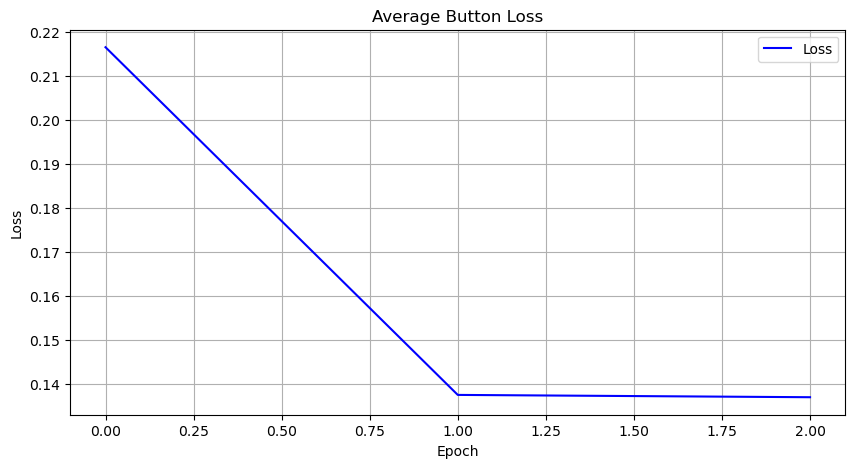

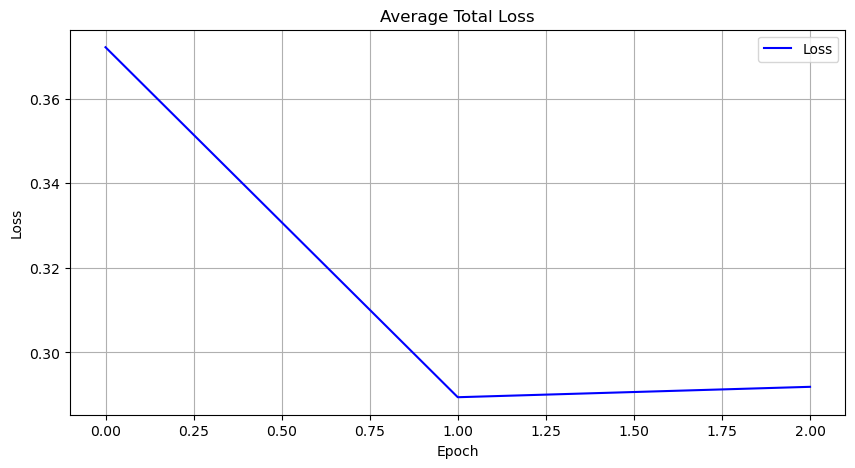

...

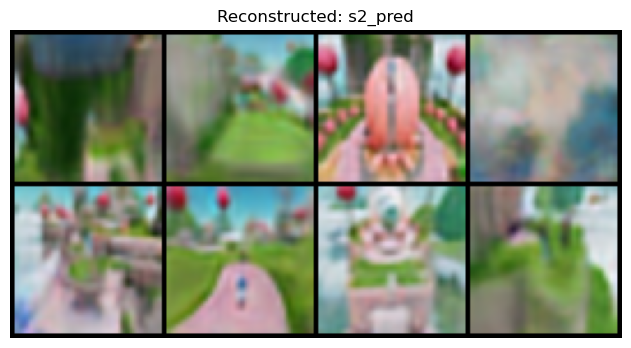

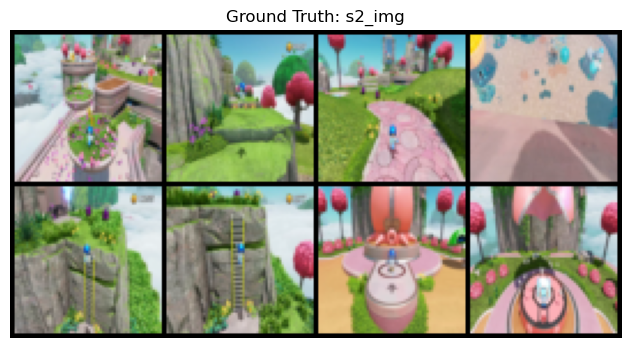

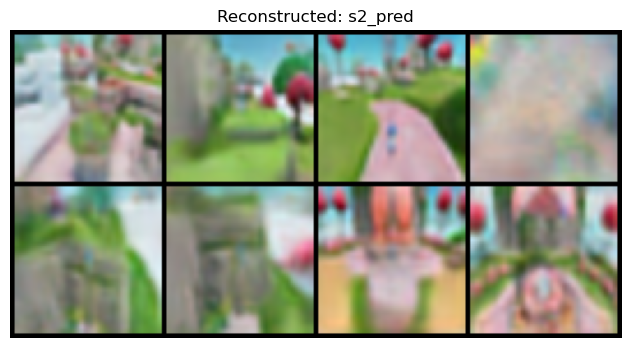

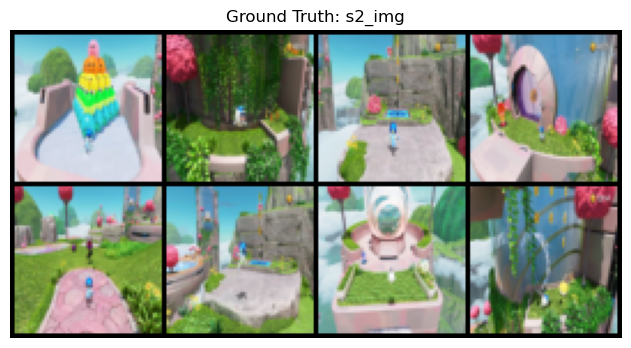

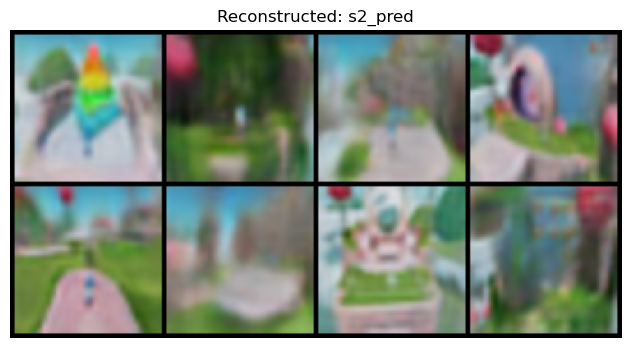

Epoch 4, Total Loss: 0.2945


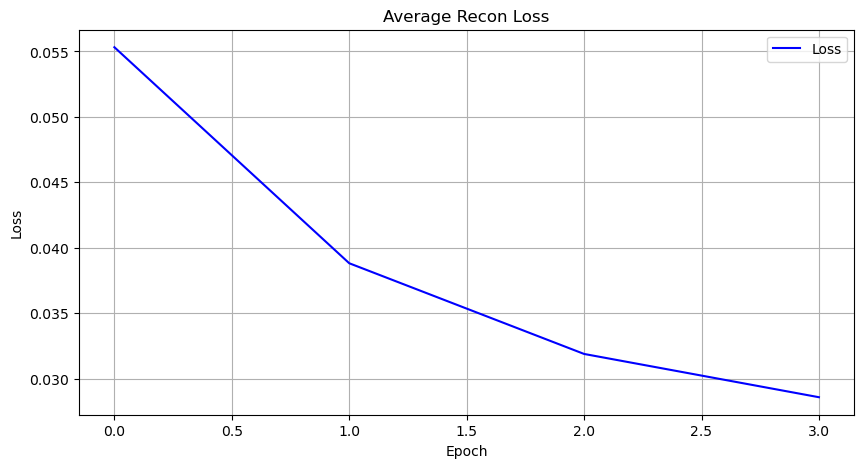

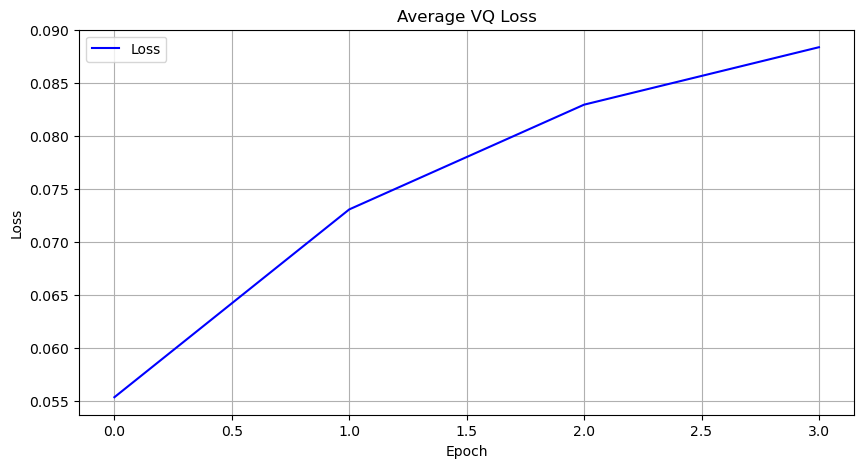

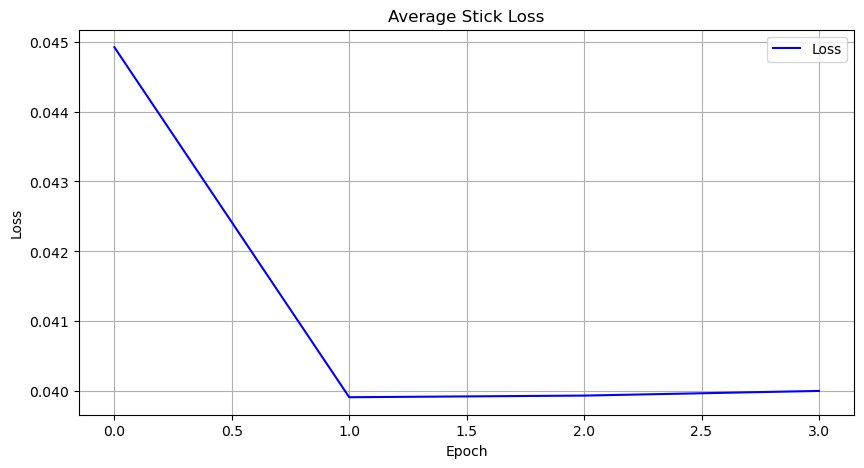

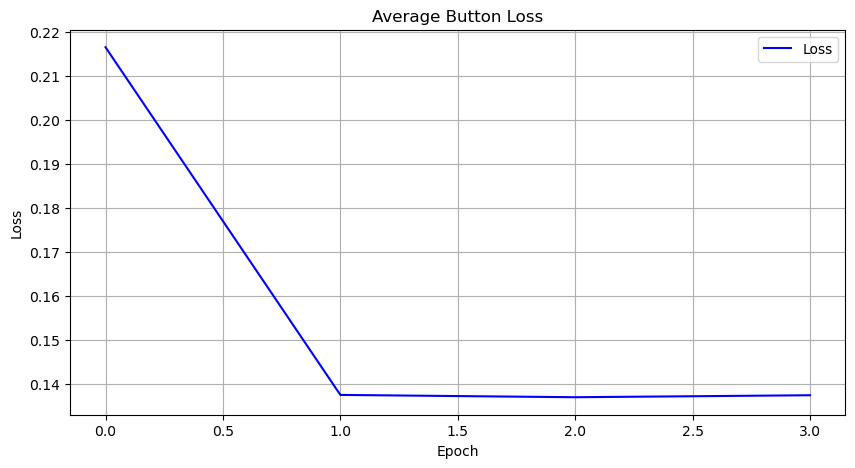

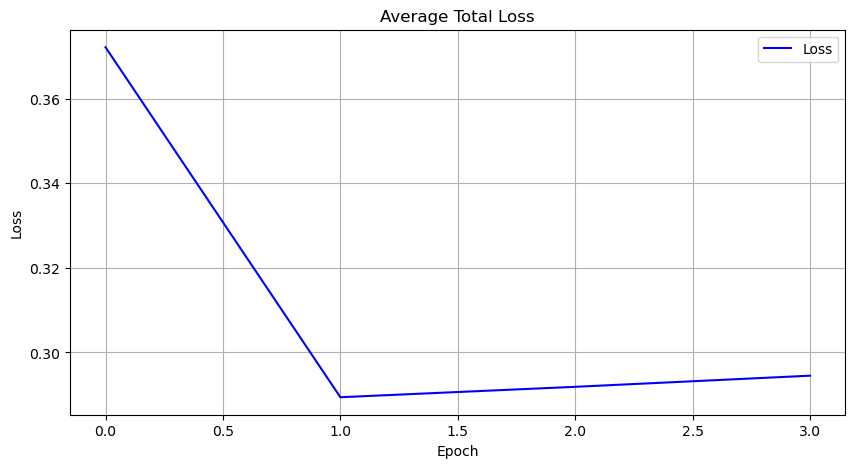

...

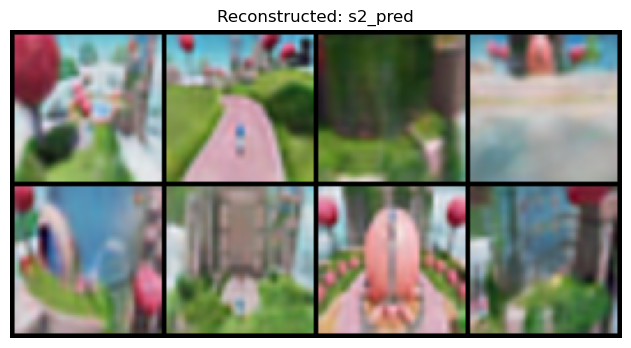

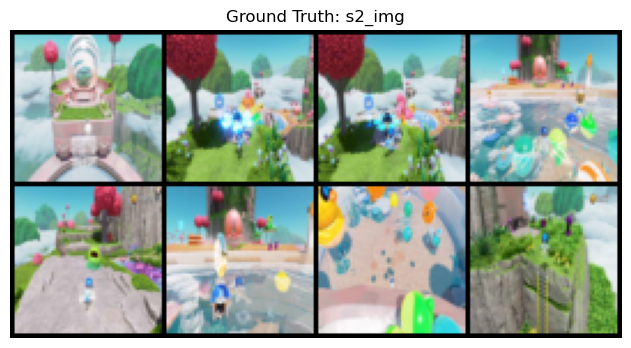

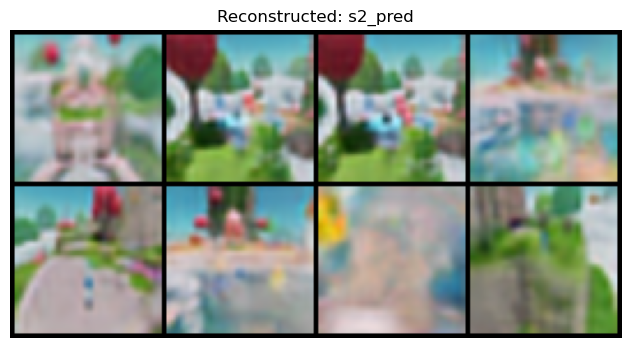

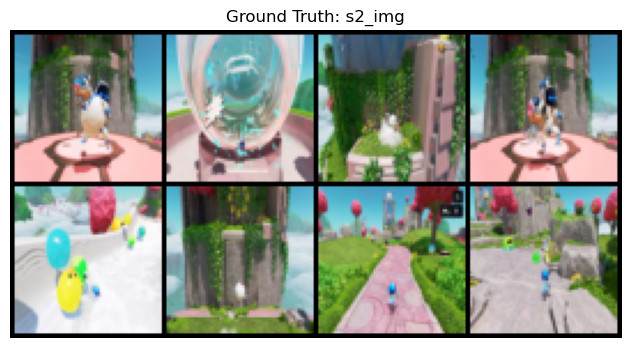

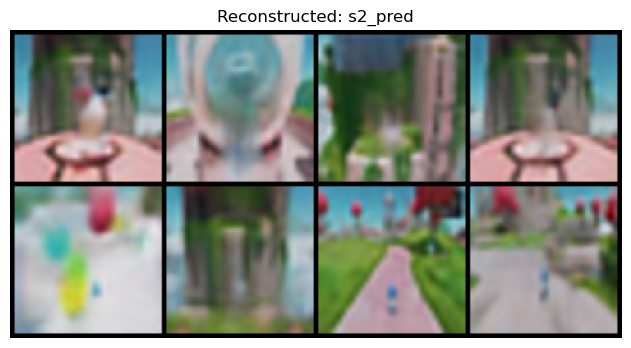

Epoch 5, Total Loss: 0.2952


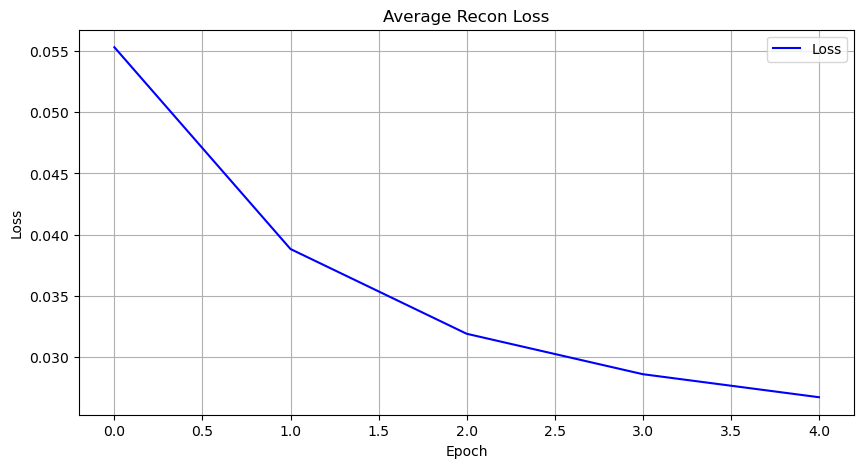

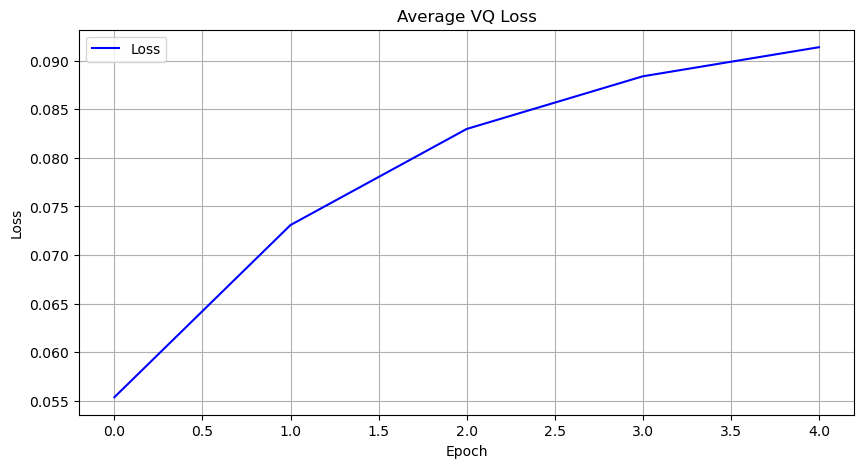

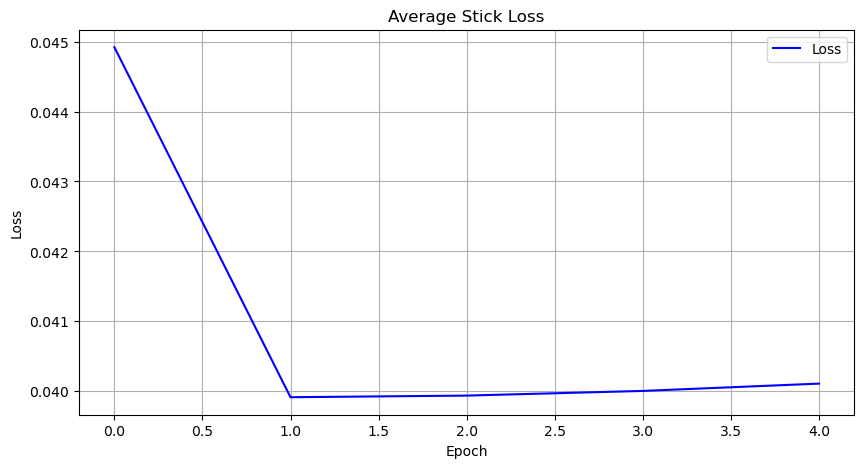

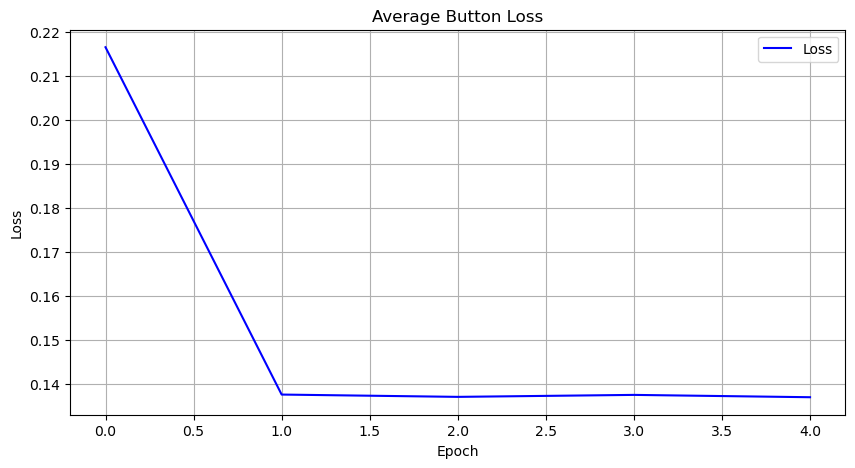

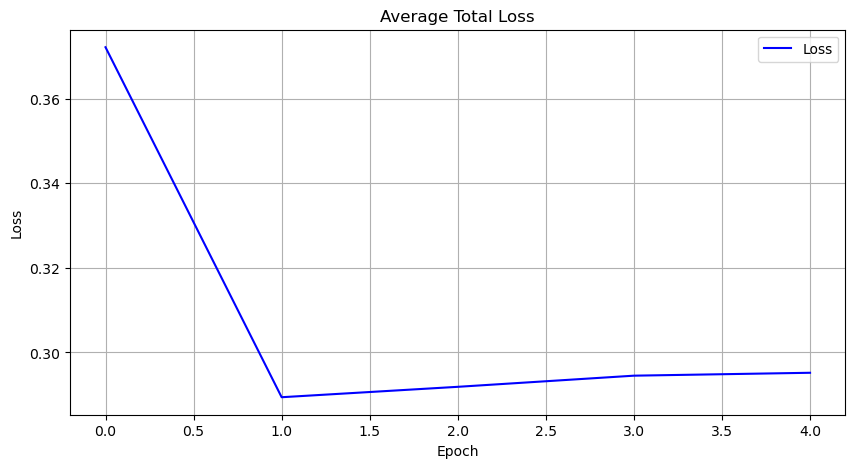

...

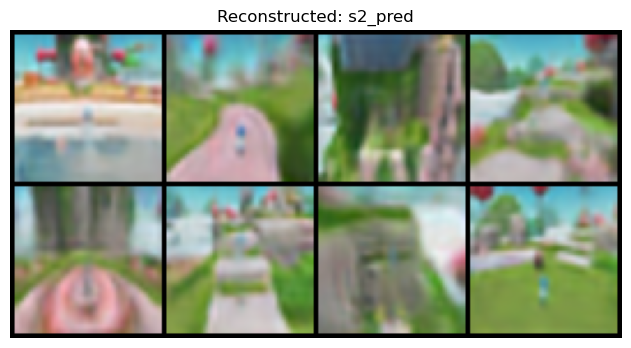

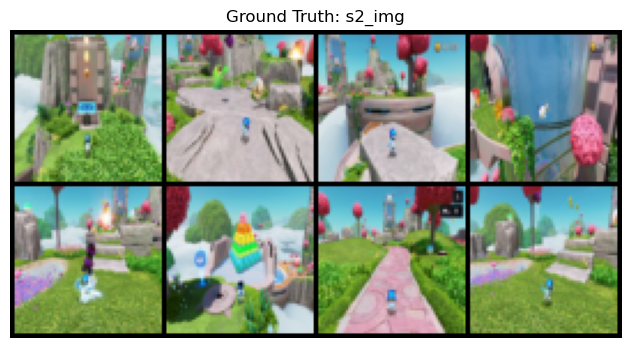

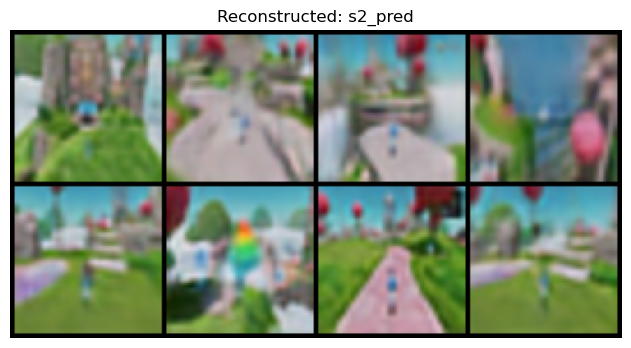

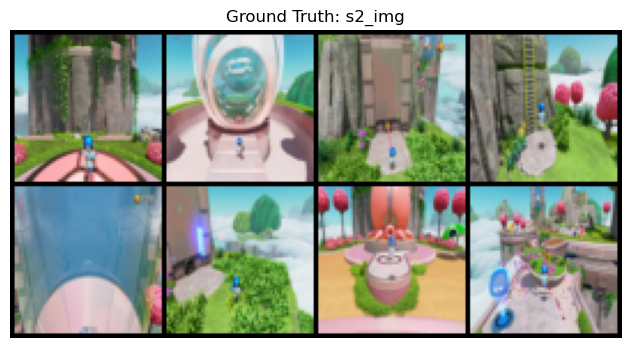

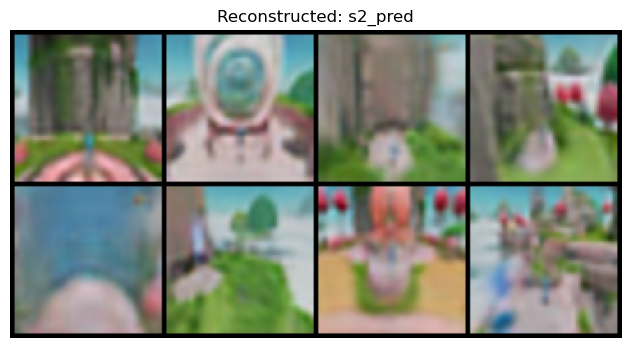

Epoch 6, Total Loss: 0.2953


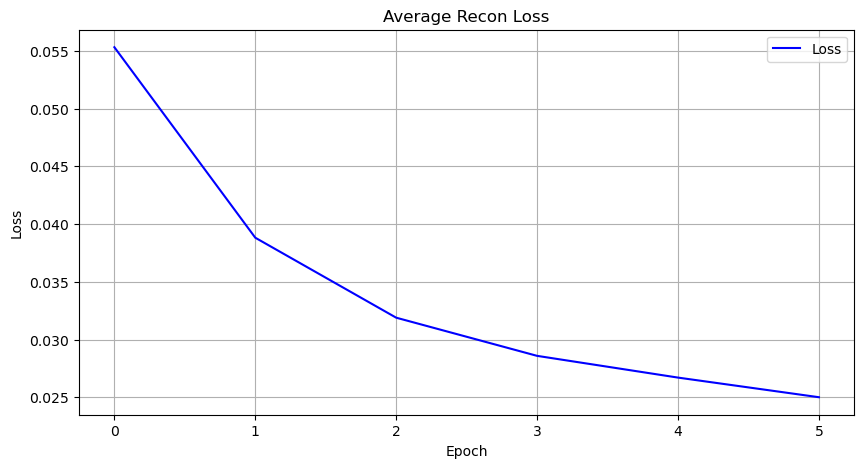

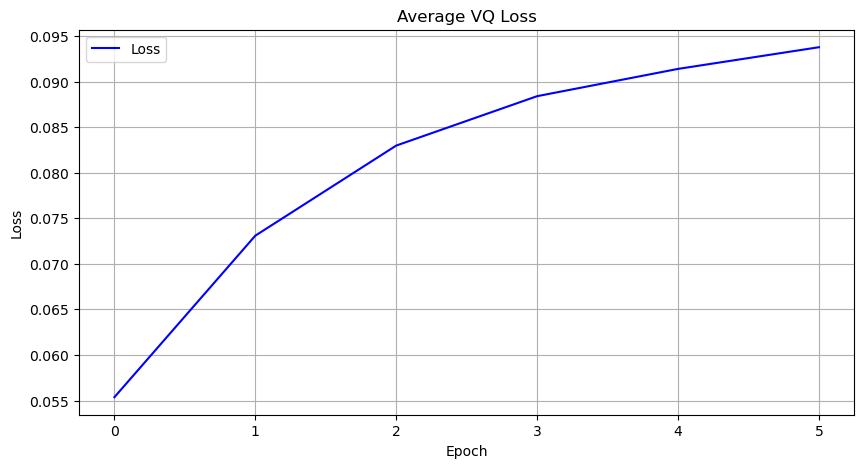

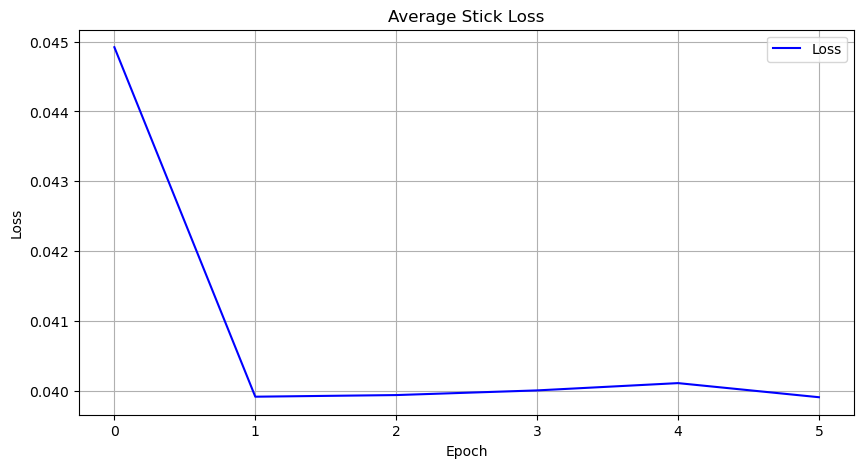

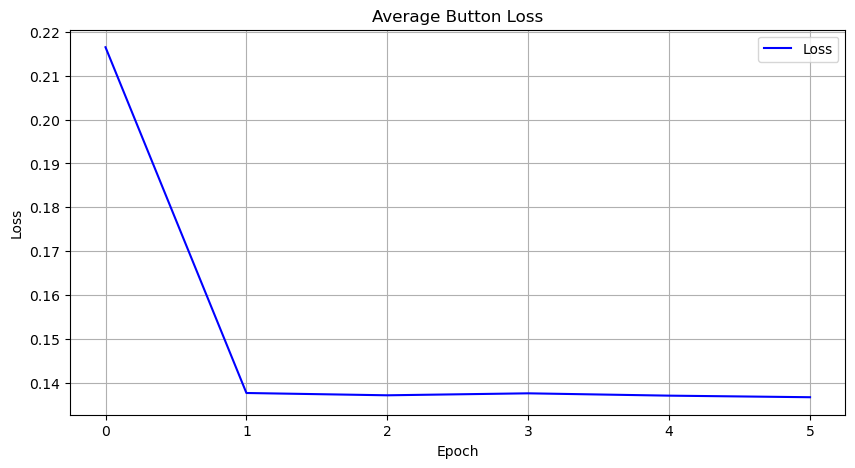

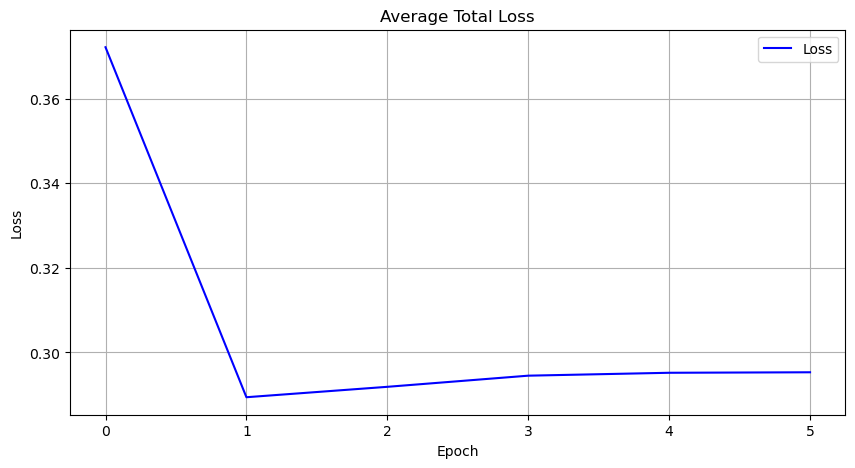

...

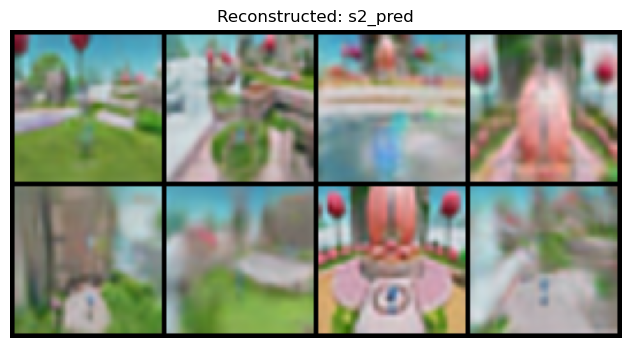

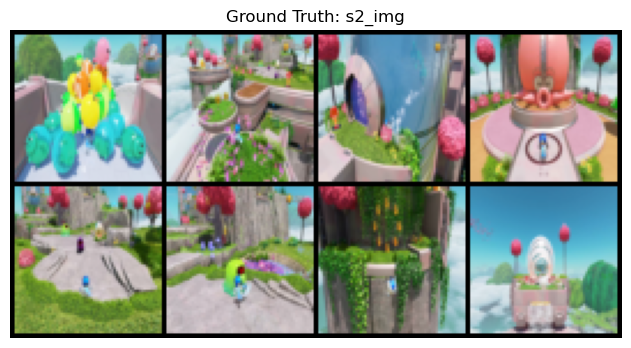

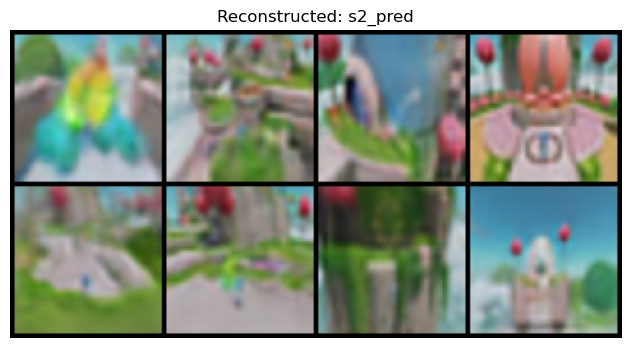

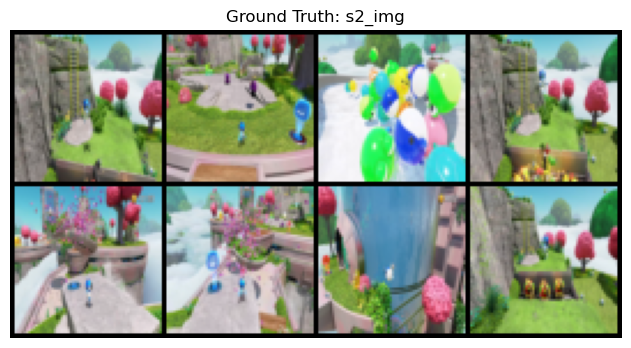

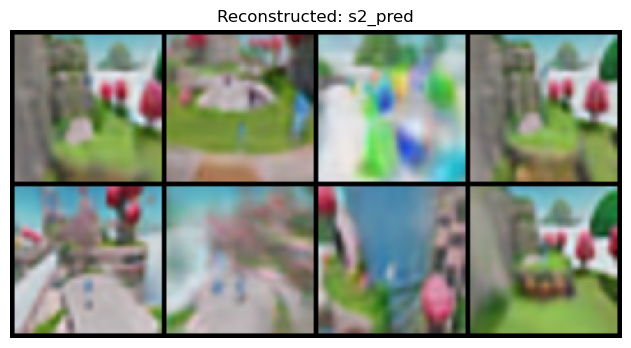

Epoch 7, Total Loss: 0.2968


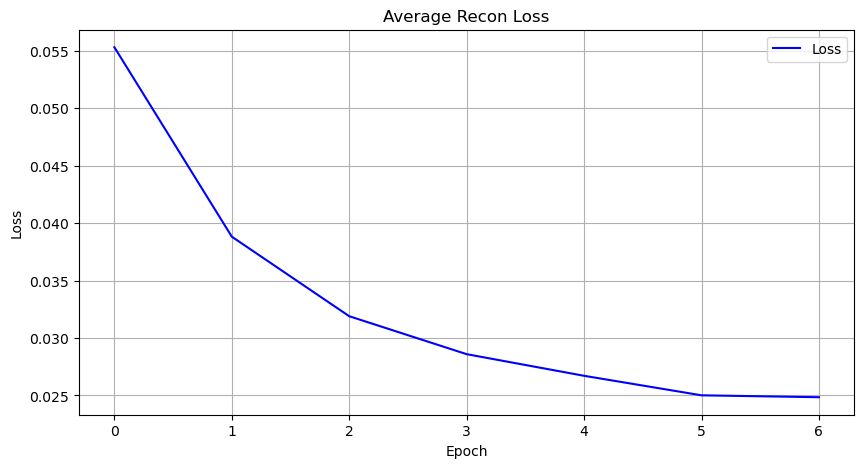

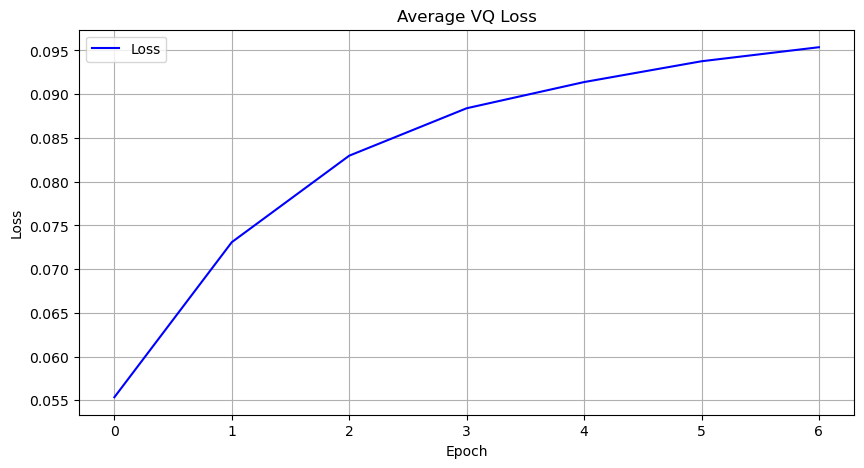

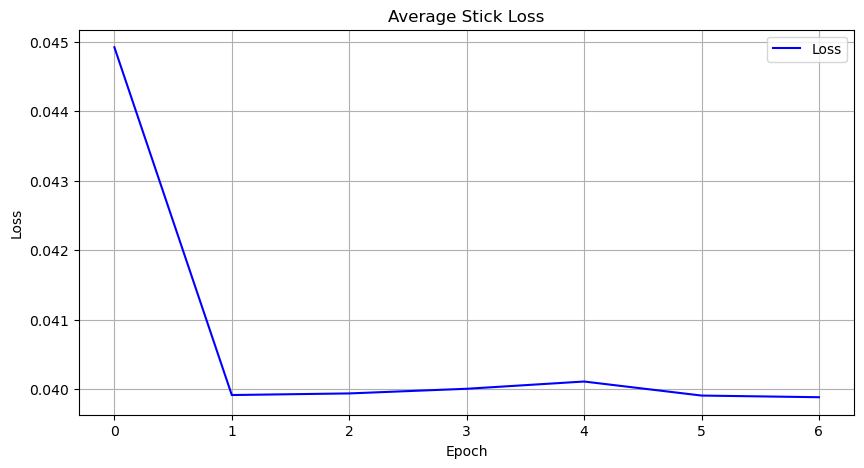

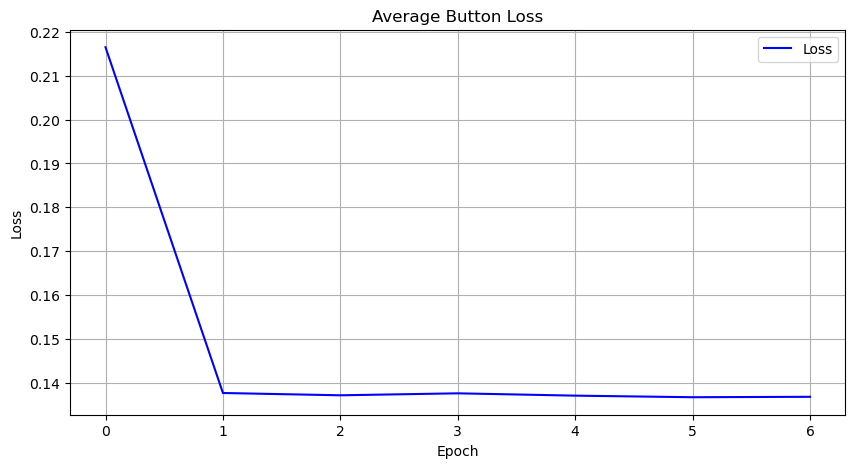

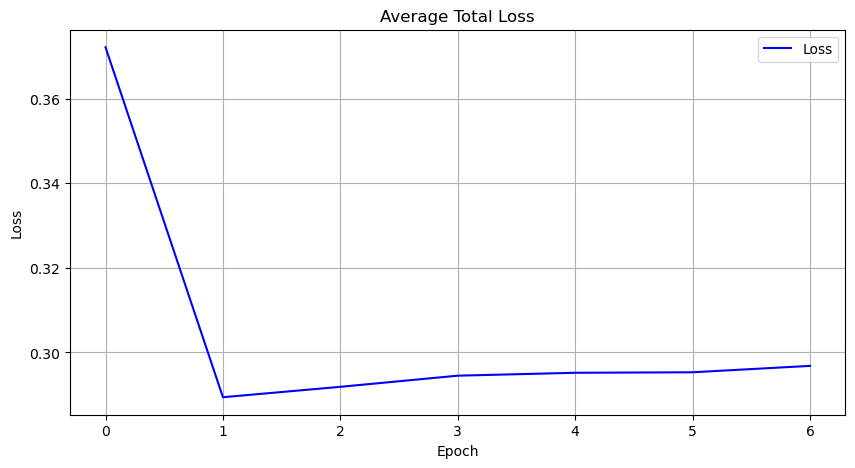

...

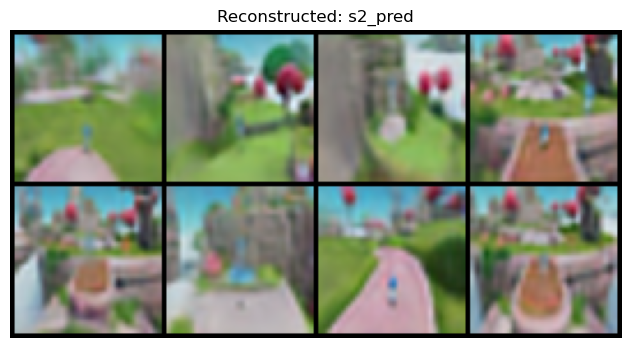

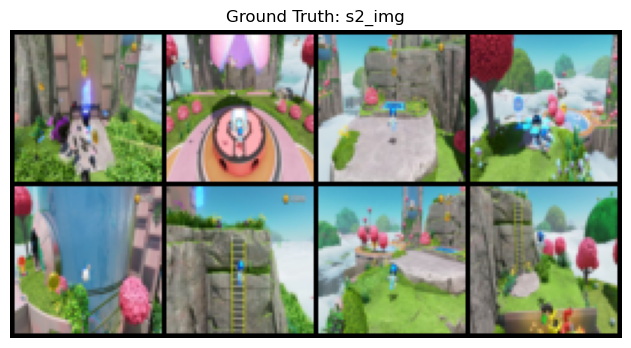

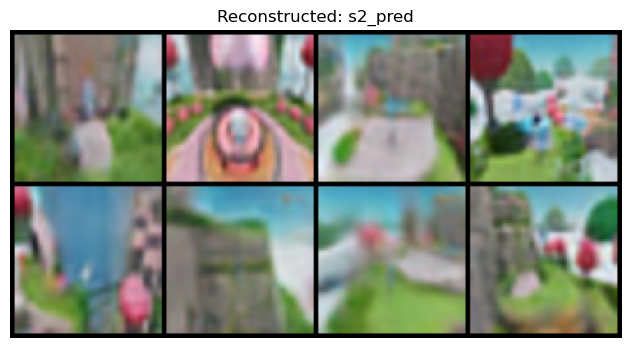

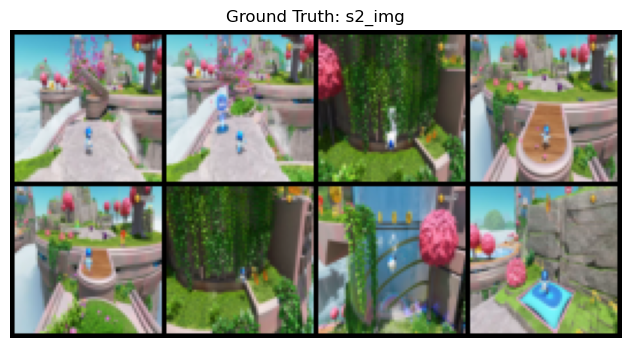

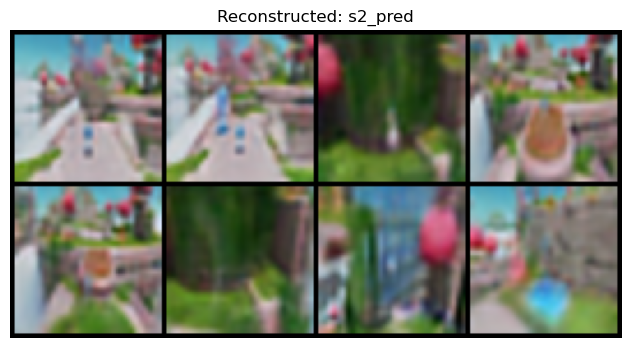

Epoch 8, Total Loss: 0.2971


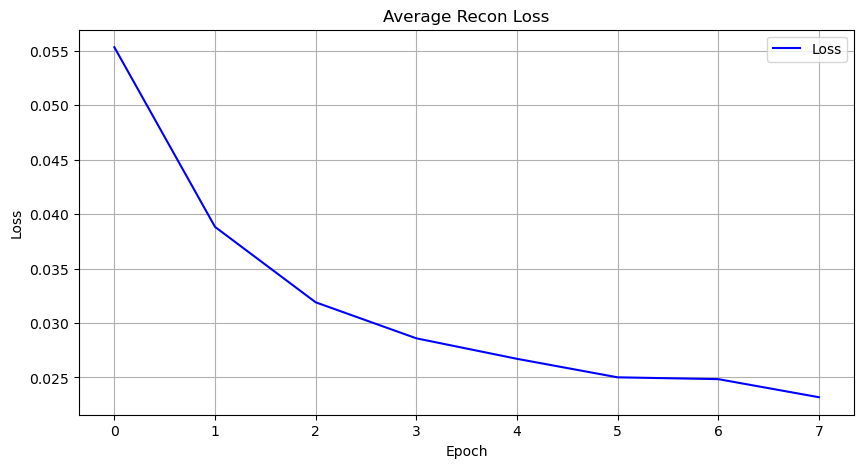

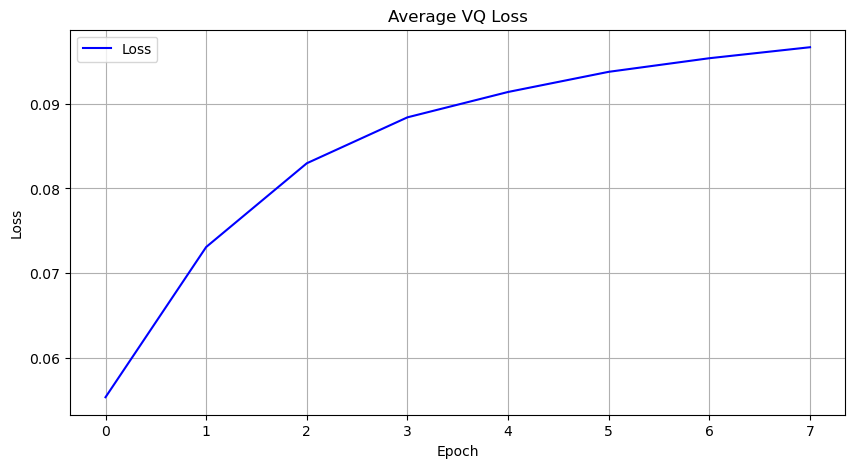

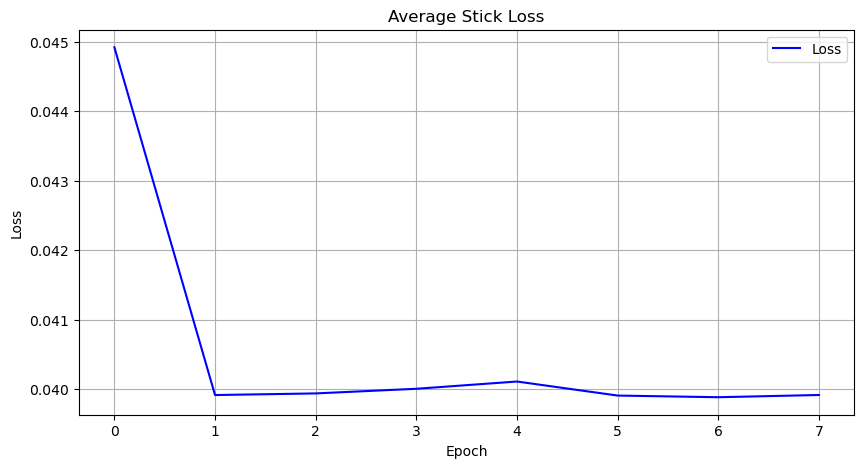

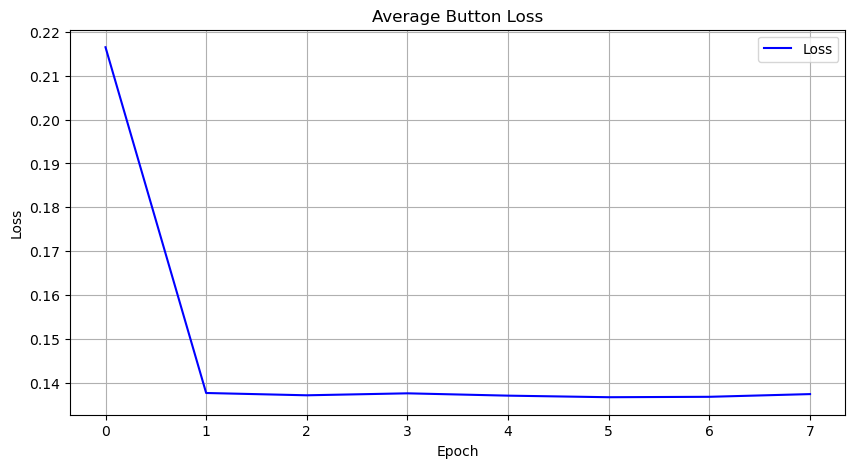

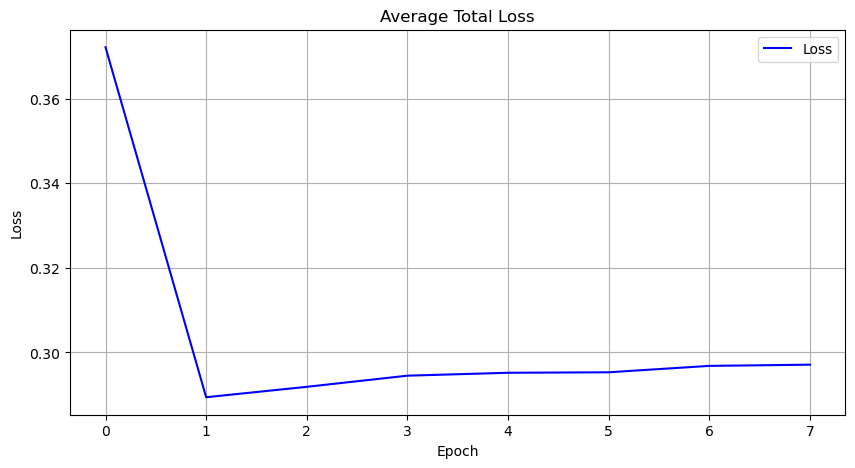

...

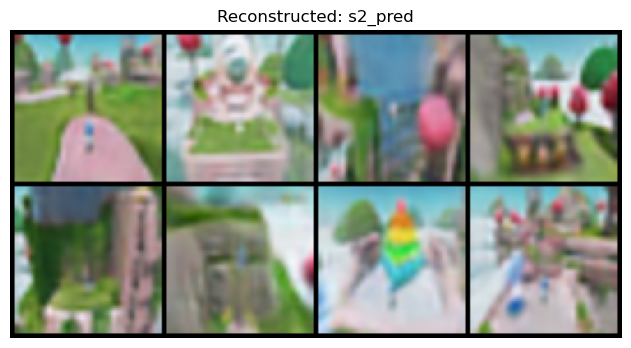

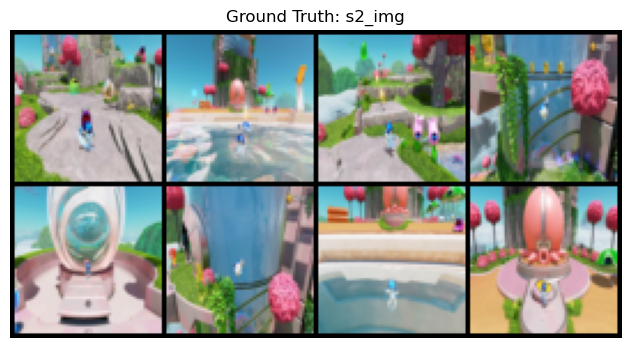

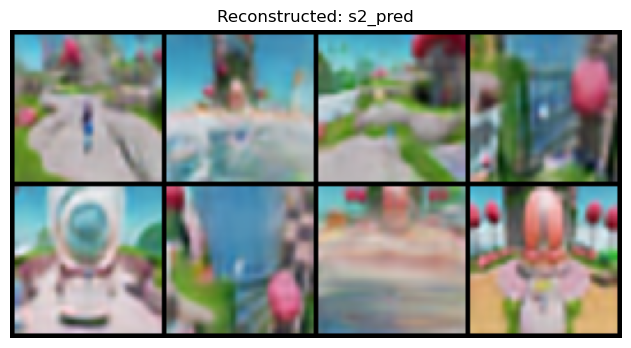

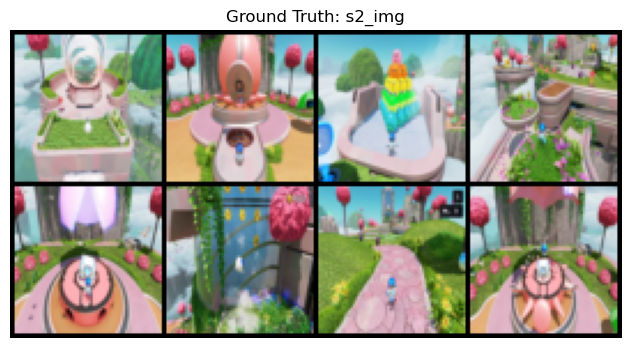

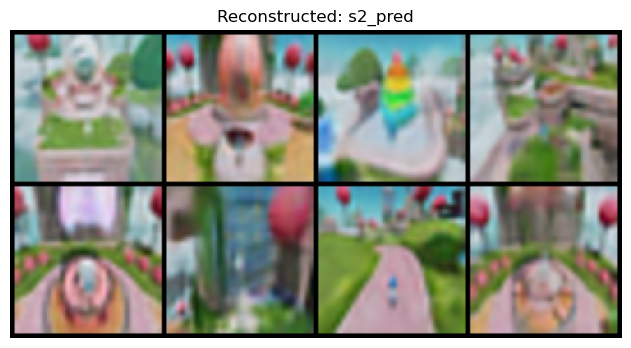

Epoch 9, Total Loss: 0.2949


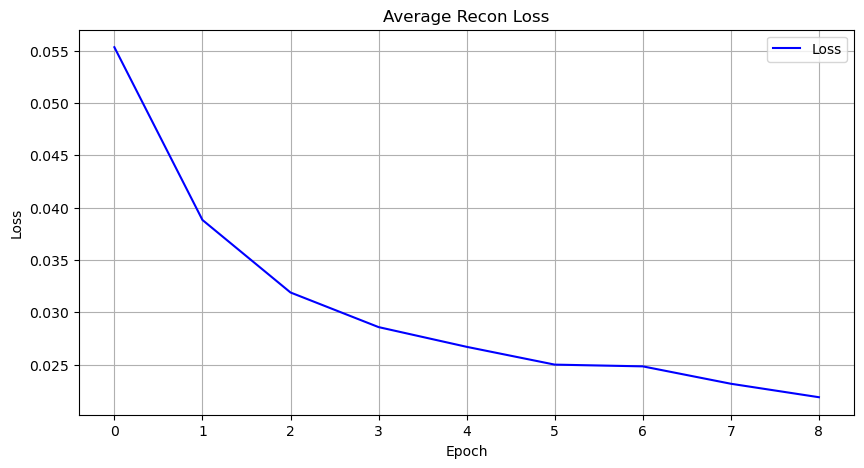

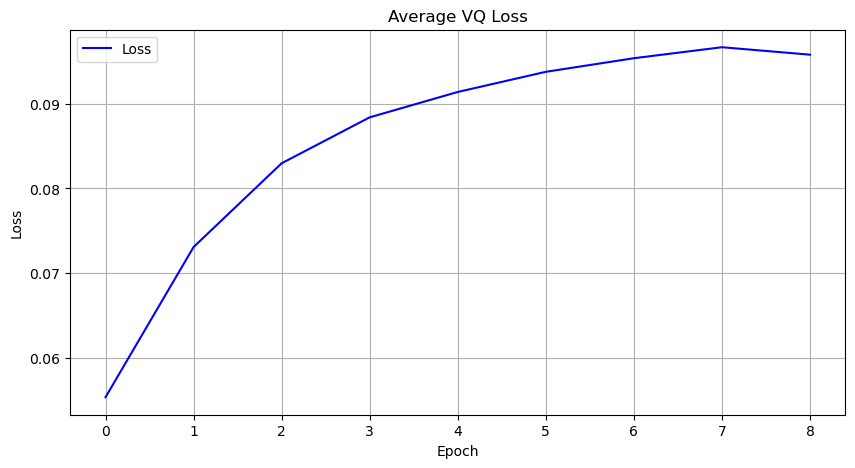

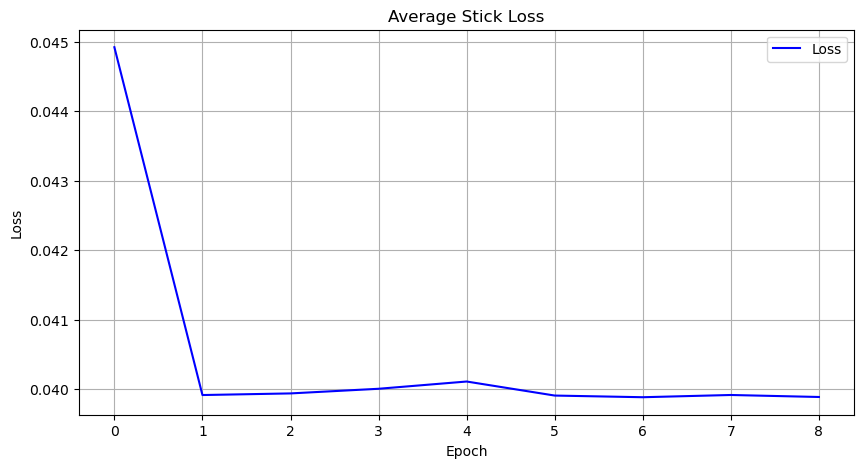

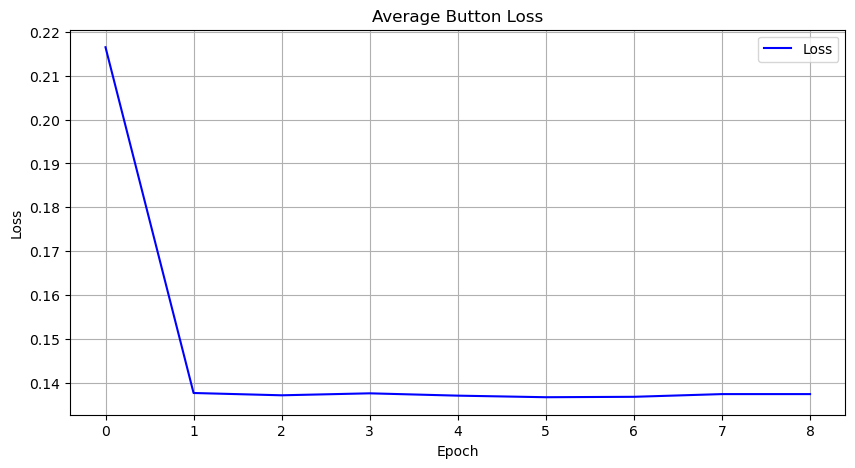

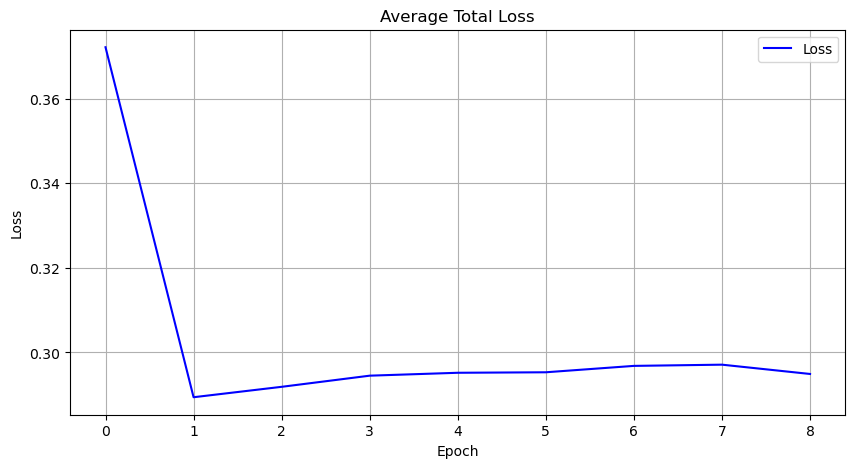

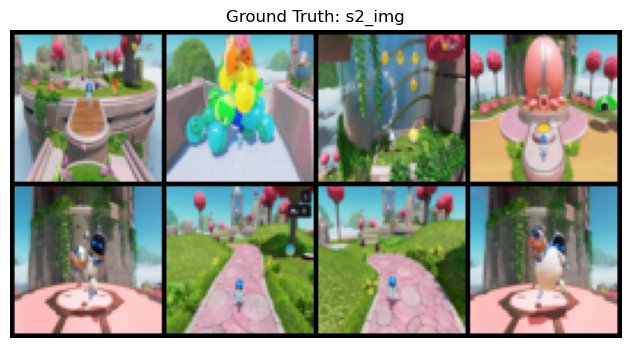

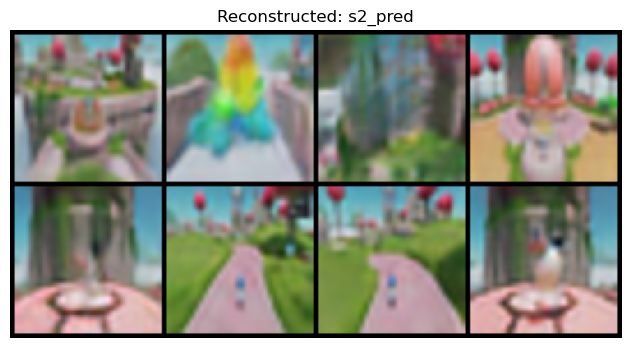

In [ ]:
def plot_losses(loss_array, title="Training Loss", ylabel="Loss", xlabel="Epoch"):
    
    
    if isinstance(loss_array, torch.Tensor):
        loss_array = loss_array.detach().cpu().numpy()
    elif isinstance(loss_array, list) and isinstance(loss_array[0], torch.Tensor):
        loss_array = [x.detach().cpu().item() for x in loss_array]
        
    plt.figure(figsize=(10, 5))
    plt.plot(loss_array, label="Loss", color="blue")
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.grid(True)
    plt.legend()
    plt.show()

def show_images(tensor_batch, title):

    # Take 8 images
    img_grid = vutils.make_grid(tensor_batch[:8].cpu(), nrow=4, normalize=True)
    plt.figure(figsize=(8, 4))
    plt.imshow(img_grid.permute(1, 2, 0))
    plt.title(title)
    plt.axis('off')
    plt.show()
    



optimizer = torch.optim.Adam(
    list(encoder.parameters()) +
    list(idm.parameters()) +
    list(vq.parameters()) +
    list(fdm.parameters())+
    list(action_decoder.parameters()),
    lr=2e-4
)

num_epochs = 10


print("----------------Start Training-----------------")

average_recon_loss = []
average_vq_loss = []
average_stick_loss = []
average_button_loss = []
average_total_loss = []
for epoch in range(num_epochs):
    total_loss = 0
    total_step = 0
    total_recon_loss = 0
    total_vq_loss = 0
    total_stick_loss = 0
    total_button_loss = 0
    
    for batch_idx, ((s1_img, s2_img), stick_action, button_action) in enumerate(dataloader):
        s1_img, s2_img,stick_action, button_action = s1_img.to(device), s2_img.to(device), stick_action.to(device), button_action.to(torch.float).to(device)
        

        # Encode states
        e1 = encoder(s1_img)  # 64x128
        e2 = encoder(s2_img)  # 64x128

        # Predict latent action
        z = idm(e1, e2)       # 64x32

        # Vector Quantization
        z_q, vq_loss = vq(z)  # 64x32

        # Decode predicted s2
        s2_pred = fdm(s1_img, z_q)  # 64x3x64x64

        if total_step%100 == 0:
            show_images(s2_img, "Ground Truth: s2_img")
            show_images(s2_pred, "Reconstructed: s2_pred")
            
        stick_pred, button_logits = action_decoder(z_q)

        # Reconstruction Loss
        recon_loss = F.mse_loss(s2_pred, s2_img)
        stick_loss = F.mse_loss(stick_pred, stick_action)  # stick 
        button_loss = F.cross_entropy(button_logits, button_action)  # button
        
        loss = recon_loss + vq_loss + stick_loss + button_loss

        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        total_recon_loss += recon_loss.item()
        total_vq_loss += vq_loss.item()
        total_stick_loss += stick_loss.item()
        total_button_loss += button_loss.item()
        total_loss += loss.item()
        total_step += 1
        
    avg_loss = total_loss / len(dataloader)
    average_recon_loss.append(total_recon_loss / len(dataloader))
    average_vq_loss.append(total_vq_loss / len(dataloader))
    average_stick_loss.append(total_stick_loss / len(dataloader))
    average_button_loss.append(total_button_loss / len(dataloader))
    average_total_loss.append(avg_loss)
    
    print(f"Epoch {epoch+1}, Total Loss: {avg_loss:.4f}")
    
    plot_losses(average_recon_loss, title="Average Recon Loss")
    plot_losses(average_vq_loss, title="Average VQ Loss")
    plot_losses(average_stick_loss, title="Average Stick Loss")
    plot_losses(average_button_loss, title="Average Button Loss")
    plot_losses(average_total_loss, title="Average Total Loss")
    
print("----------------Training Done-----------------")

# Save all models' parameters
save_dir = "C:\\Users\\44753\\Desktop\\SavedModels"
os.makedirs(save_dir, exist_ok=True)  # Create path if not exist

torch.save(encoder.state_dict(), os.path.join(save_dir, "encoder.pth"))
torch.save(idm.state_dict(), os.path.join(save_dir, "idm.pth"))
torch.save(vq.state_dict(), os.path.join(save_dir, "vq.pth"))
torch.save(fdm.state_dict(), os.path.join(save_dir, "fdm.pth"))
torch.save(action_decoder.state_dict(), os.path.join(save_dir, "action_decoder.pth"))

print(f"Models Saved! {save_dir}")



In [21]:
import matplotlib.pyplot as plt
import torchvision.transforms.functional as TF
import torch

def show_tensor_image(tensor_img):
   
    if isinstance(tensor_img, torch.Tensor):
        img = tensor_img.clone().detach()

        # recover to [0, 1]
        if img.min() < 0:
            img = (img + 1) / 2

        img = TF.to_pil_image(img)

        plt.imshow(img)
        plt.axis("off")
        plt.show()


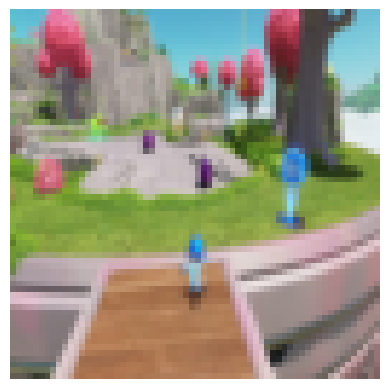

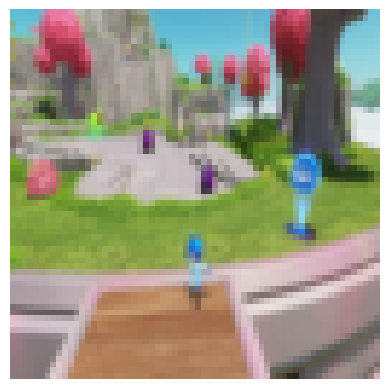

In [54]:
show_tensor_image(dataset.__getitem__(699)[0][0])
show_tensor_image(dataset.__getitem__(699)[0][1])